In [1]:
import numpy as np
import os
import tensorflow as tf
from tensorflow.keras.utils import load_img, img_to_array
import matplotlib.pyplot as plt

In [2]:
# veri seti / dataset -> https://www.kaggle.com/datasets/khoongweihao/covid19-xray-dataset-train-test-sets
path="C:/Users/Dell/Desktop/veri bilimi çalışmalar/Covid 19 CNN/xray_dataset_covid19/train/NORMAL/"
image_labels = os.listdir(path)

images=[]
for i in image_labels:
    img=load_img(path+i, color_mode='grayscale', target_size=(128,128), interpolation='nearest')
    images.append(img_to_array(img))
images=np.array(images)

In [3]:
images = (images - 127.5) / 127.5
images.shape

(74, 128, 128, 1)

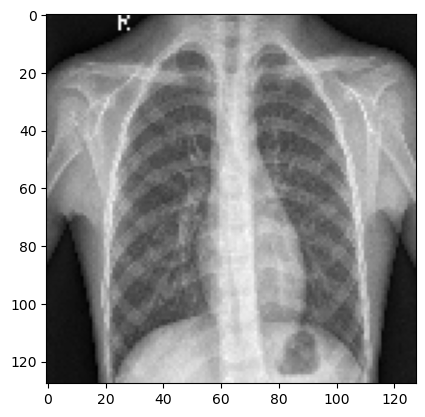

IM-0001-0001.jpeg
(128, 128, 1)


In [4]:
plt.imshow(images[0], cmap='gray')
plt.show()
print(image_labels[0])
print(images[0].shape)

In [5]:
%matplotlib inline
import matplotlib.pyplot as plt

def display(images, row=2, col=10):
    fig = plt.figure(figsize=(20, 3))
    it = 0
    for r in range(row):
        for c in range(col):
            ax = plt.subplot(row, col, it + 1)
            ax.set_axis_off()
            ax.imshow(images[it, :, :, 0] * 127.5 + 127.5, cmap='gray')
            it += 1
    return fig

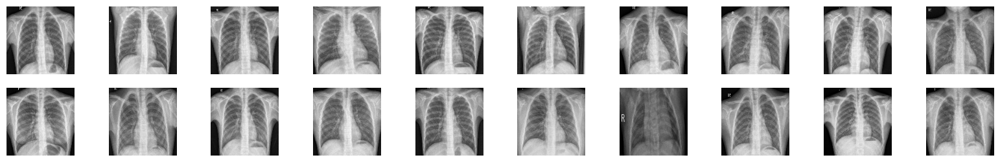

In [6]:
display(images);

In [7]:
data_generator = tf.data.Dataset.from_tensor_slices(images).shuffle(10).batch(4, drop_remainder=True)

In [8]:
from tensorflow.keras.layers import Conv2D, Conv2DTranspose
from tensorflow.keras.layers import BatchNormalization, Input, Flatten
from tensorflow.keras.layers import LeakyReLU
from tensorflow.keras.models import Model

def get_generator():
    
    input_noise = Input(shape=(1, 1, 100))

    x=Conv2DTranspose(2048, kernel_size=4, strides=1, padding='valid')(input_noise)
    x=BatchNormalization()(x)
    x=LeakyReLU(0.2)(x)
    
    x=Conv2DTranspose(1024, kernel_size=4, strides=2, padding='same')(x)
    x=BatchNormalization()(x)
    x=LeakyReLU(0.2)(x)
    
    x=Conv2DTranspose(512, kernel_size=4, strides=2, padding='same')(x)
    x=BatchNormalization()(x)
    x=LeakyReLU(0.2)(x)
    
    x=Conv2DTranspose(256, kernel_size=4, strides=2, padding='same')(x)
    x=BatchNormalization()(x)
    x=LeakyReLU(0.2)(x)
    
    x=Conv2DTranspose(128, kernel_size=4, strides=2, padding='same')(x)
    x=BatchNormalization()(x)
    x=LeakyReLU(0.2)(x)
    
    x=Conv2DTranspose(1, kernel_size=4, strides=2, padding='same', activation='tanh')(x)
    
    return Model(inputs=input_noise, outputs=x)


def get_discriminator():
 
    input_image = Input(shape=(128, 128, 1))

    x = Conv2D(128, kernel_size=4, strides=2, padding="same")(input_image)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(256, kernel_size=4, strides=2, padding="same")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(512, kernel_size=4, strides=2, padding="same")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(1024, kernel_size=4, strides=2, padding="same")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(2048, kernel_size=4, strides=2, padding="same")(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.2)(x)

    x = Conv2D(1, kernel_size=4, strides=1, padding="valid")(x)
    x = Flatten()(x)

    return Model(inputs=input_image, outputs=x)

generator = get_generator()
discriminator = get_discriminator()

C:\Users\Dell\anaconda3\Lib\site-packages\keras\src\layers\activations\leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


In [9]:
def get_noise(batch_size, nz=100):
    return tf.random.normal([batch_size, 1, 1, nz])

noise = get_noise(16)

print("init", noise.shape)
fake_images = generator(noise)
print("Fake images", fake_images.shape)  # Should be (_, 128, 128, 1)
preds = discriminator(fake_images)
print("Predictions", preds.shape)  # Should be (_, 1)

init (16, 1, 1, 100)
Fake images (16, 128, 128, 1)
Predictions (16, 1)


In [10]:
generator.summary()
discriminator.summary()

Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)        │ (None, 1, 1, 100)      │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose                │ (None, 4, 4, 2048)     │     3,278,848 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization             │ (None, 4, 4, 2048)     │         8,192 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu (LeakyReLU)         │ (None, 4, 4, 2048)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_1              │ (None, 8, 8, 1024)     │    33,555,456 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_1           │ (None, 8, 8, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_1 (LeakyReLU)       │ (None, 8, 8, 1024)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_2              │ (None, 16, 16, 512)    │     8,389,120 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_2           │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_2 (LeakyReLU)       │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_3              │ (None, 32, 32, 256)    │     2,097,408 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_3           │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_3 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_4              │ (None, 64, 64, 128)    │       524,416 │
│ (Conv2DTranspose)               │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_4           │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_4 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_transpose_5              │ (None, 128, 128, 1)    │         2,049 │
│ (Conv2DTranspose)               │                        │               │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 47,863,169 (182.58 MB)

 Trainable params: 47,855,233 (182.55 MB)

 Non-trainable params: 7,936 (31.00 KB)

Model: "functional_1"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━┓
┃ Layer (type)                    ┃ Output Shape           ┃       Param # ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━┩
│ input_layer_1 (InputLayer)      │ (None, 128, 128, 1)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d (Conv2D)                 │ (None, 64, 64, 128)    │         2,176 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_5           │ (None, 64, 64, 128)    │           512 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_5 (LeakyReLU)       │ (None, 64, 64, 128)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_1 (Conv2D)               │ (None, 32, 32, 256)    │       524,544 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_6           │ (None, 32, 32, 256)    │         1,024 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_6 (LeakyReLU)       │ (None, 32, 32, 256)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_2 (Conv2D)               │ (None, 16, 16, 512)    │     2,097,664 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_7           │ (None, 16, 16, 512)    │         2,048 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_7 (LeakyReLU)       │ (None, 16, 16, 512)    │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_3 (Conv2D)               │ (None, 8, 8, 1024)     │     8,389,632 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_8           │ (None, 8, 8, 1024)     │         4,096 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_8 (LeakyReLU)       │ (None, 8, 8, 1024)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_4 (Conv2D)               │ (None, 4, 4, 2048)     │    33,556,480 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ batch_normalization_9           │ (None, 4, 4, 2048)     │         8,192 │
│ (BatchNormalization)            │                        │               │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ leaky_re_lu_9 (LeakyReLU)       │ (None, 4, 4, 2048)     │             0 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ conv2d_5 (Conv2D)               │ (None, 1, 1, 1)        │        32,769 │
├─────────────────────────────────┼────────────────────────┼───────────────┤
│ flatten (Flatten)               │ (None, 1)              │             0 │
└─────────────────────────────────┴────────────────────────┴───────────────┘

 Total params: 44,619,137 (170.21 MB)

 Trainable params: 44,611,201 (170.18 MB)

 Non-trainable params: 7,936 (31.00 KB)

In [11]:
from tensorflow.keras.losses import binary_crossentropy

def discriminator_loss(preds_real, preds_fake):
    loss_real = binary_crossentropy(tf.ones_like(preds_real), preds_real, from_logits=True)
    loss_fake = binary_crossentropy(tf.zeros_like(preds_fake), preds_fake, from_logits=True)
    return loss_real + loss_fake

def generator_loss(preds_fake):
    return binary_crossentropy(tf.ones_like(preds_fake), preds_fake, from_logits=True)

In [12]:
from tensorflow.keras.optimizers import Adam

optimizer_d = Adam(learning_rate=1e-4, beta_1=0.5)
optimizer_g = Adam(learning_rate=1e-4, beta_1=0.5)

In [13]:
@tf.function
def train_step(images):
    noise = get_noise(images.shape[0])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        real_output = discriminator(images, training=True)
        fake_output = discriminator(generated_images, training=True)

        gen_loss = generator_loss(preds_fake=fake_output)
        disc_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(gen_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(disc_loss, discriminator.trainable_variables)

    optimizer_g.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    optimizer_d.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return disc_loss, gen_loss

Base noise:


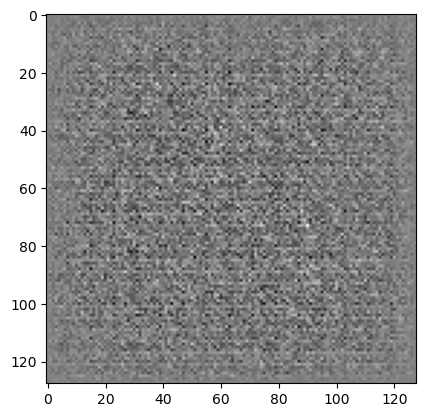

====== Epoch  0 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7617660760879517, Generator: 17.493694305419922


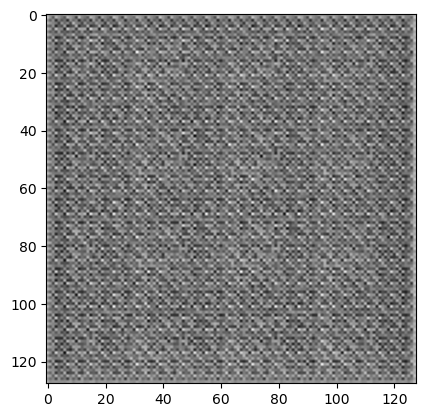

====== Epoch  1 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 1.2804034948349, Generator: 42.20032501220703


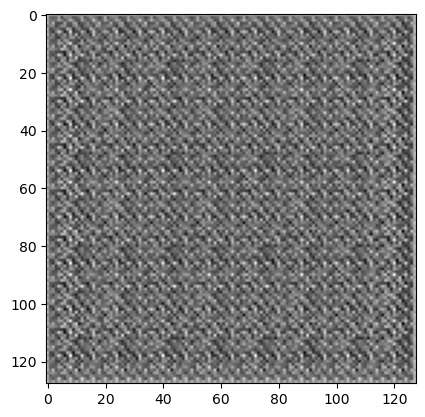

====== Epoch  2 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8398005366325378, Generator: 48.31808853149414


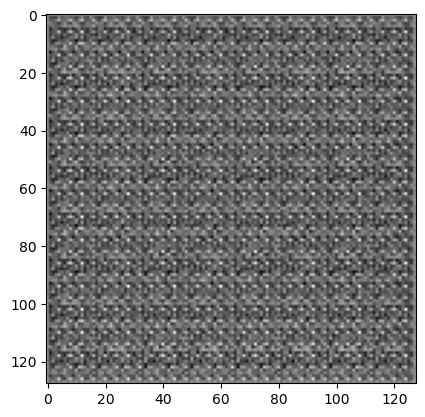

====== Epoch  3 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5066207051277161, Generator: 48.353851318359375


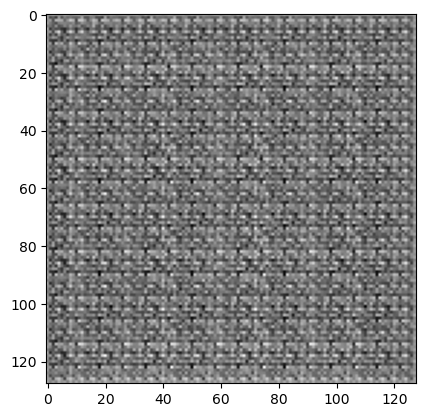

====== Epoch  4 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.30264487862586975, Generator: 51.25239562988281


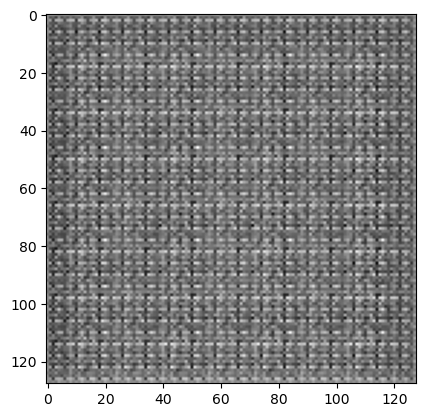

====== Epoch  5 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 1.362993597984314, Generator: 22.35177993774414


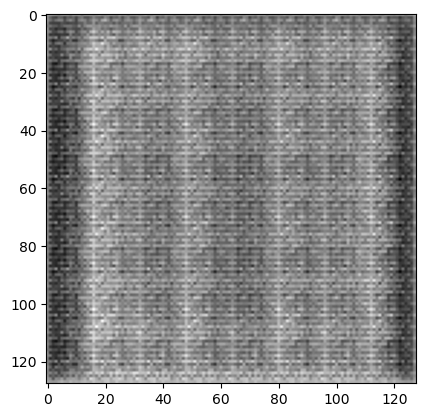

====== Epoch  6 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4215318262577057, Generator: 16.07097625732422


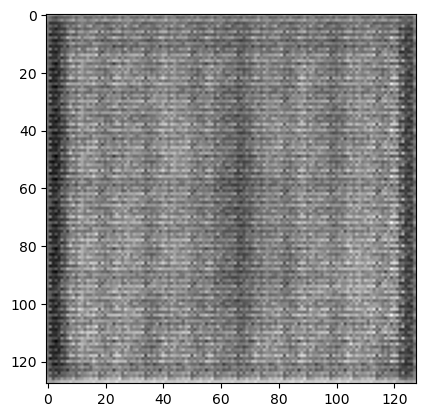

====== Epoch  7 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6320789456367493, Generator: 15.83078670501709


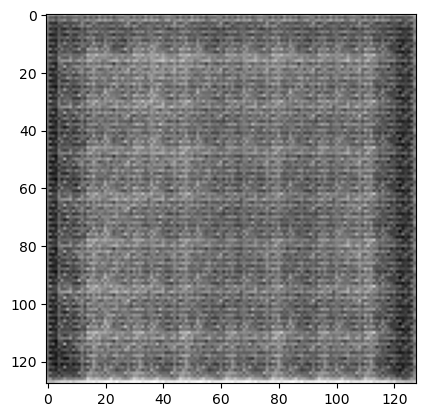

====== Epoch  8 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8547062873840332, Generator: 12.975577354431152


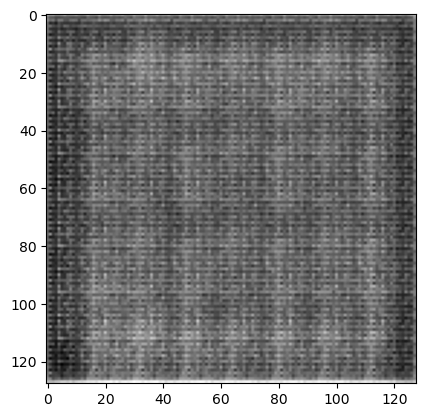

====== Epoch  9 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6952153444290161, Generator: 10.821216583251953


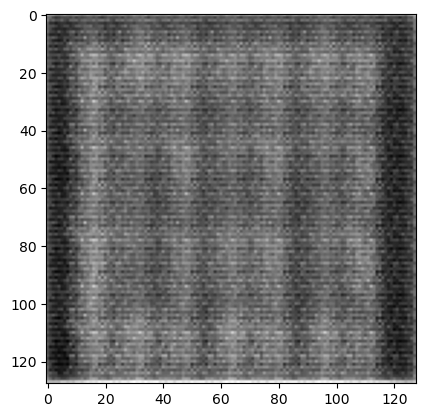

====== Epoch 10 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.9292151927947998, Generator: 12.928156852722168


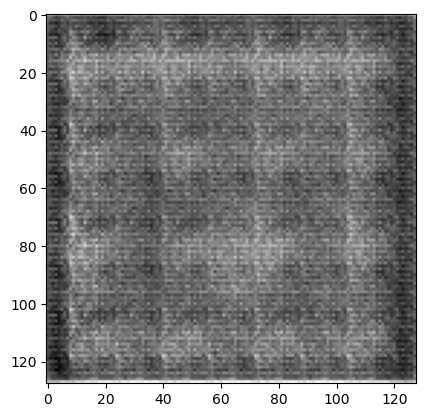

====== Epoch 11 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6367975473403931, Generator: 10.772533416748047


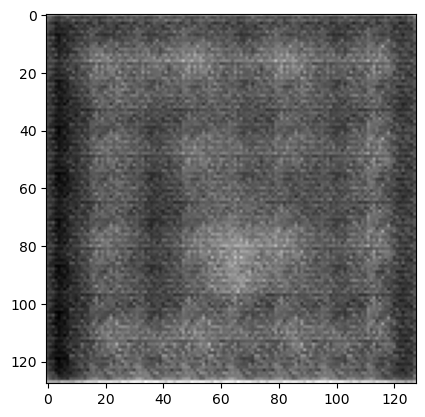

====== Epoch 12 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.9383037090301514, Generator: 7.120617389678955


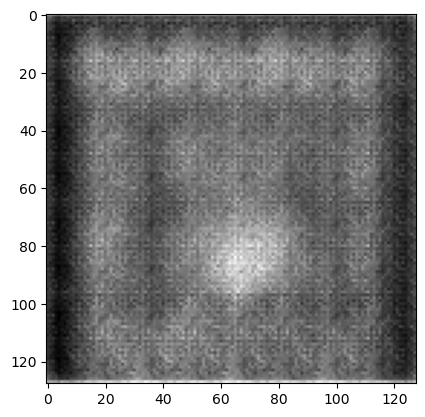

====== Epoch 13 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.539261519908905, Generator: 9.855114936828613


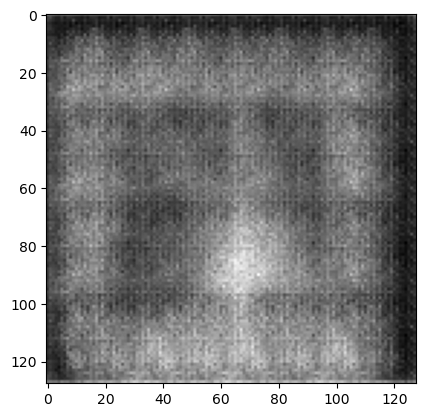

====== Epoch 14 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.12763698399066925, Generator: 7.69616174697876


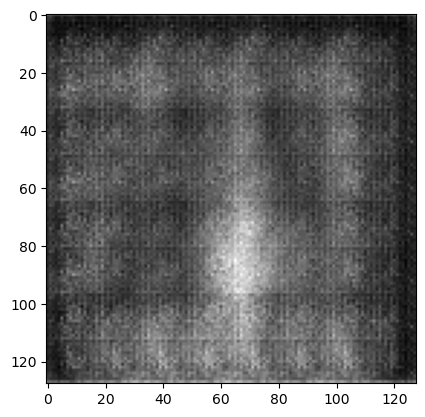

====== Epoch 15 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.920029878616333, Generator: 6.4721760749816895


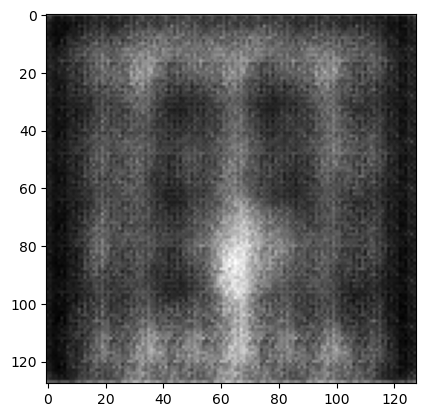

====== Epoch 16 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5775762796401978, Generator: 7.470817565917969


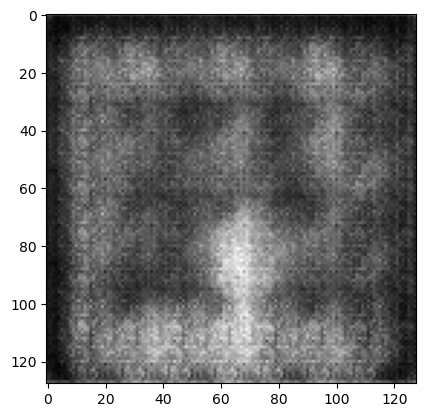

====== Epoch 17 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4109206199645996, Generator: 7.768770694732666


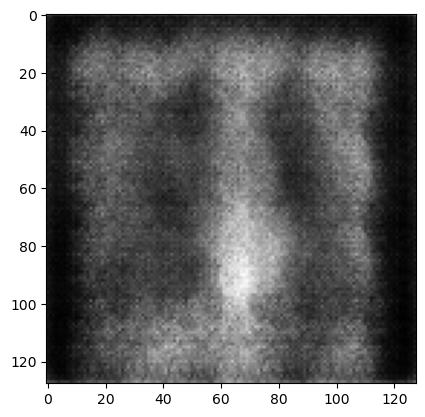

====== Epoch 18 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7067636847496033, Generator: 7.994182109832764


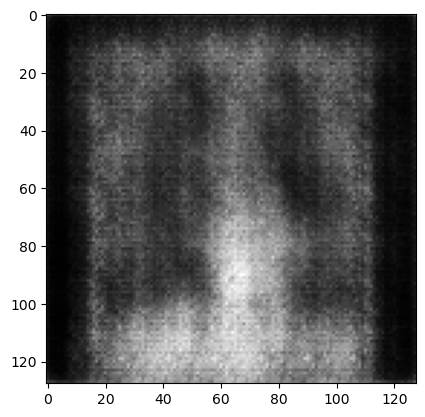

====== Epoch 19 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7809131145477295, Generator: 7.538107872009277


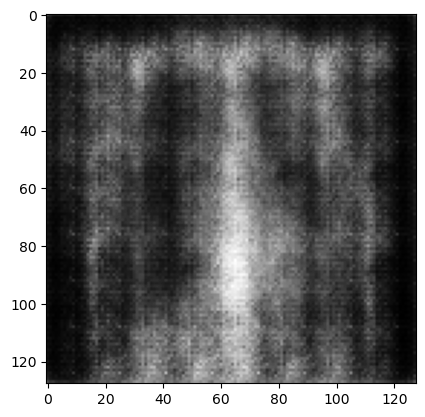

====== Epoch 20 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8023450374603271, Generator: 7.255439758300781


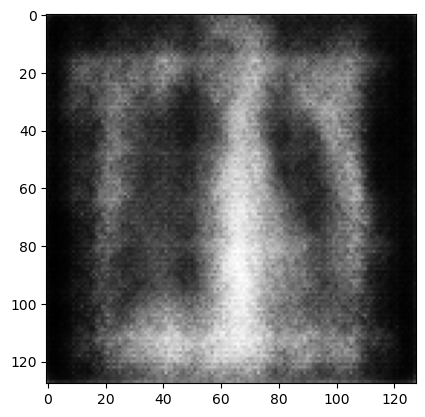

====== Epoch 21 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6436265110969543, Generator: 7.562790870666504


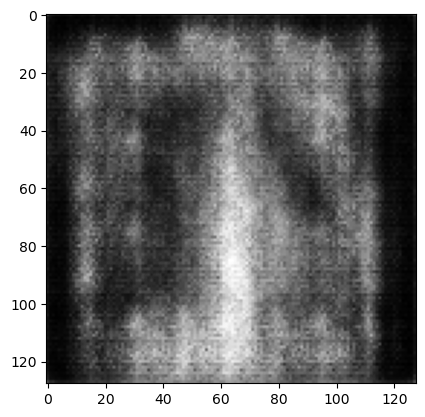

====== Epoch 22 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 1.0194525718688965, Generator: 6.747098922729492


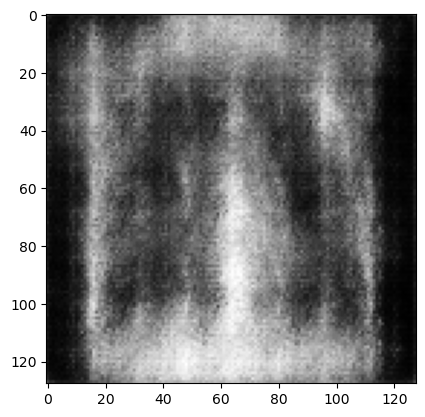

====== Epoch 23 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7425146102905273, Generator: 5.346704006195068


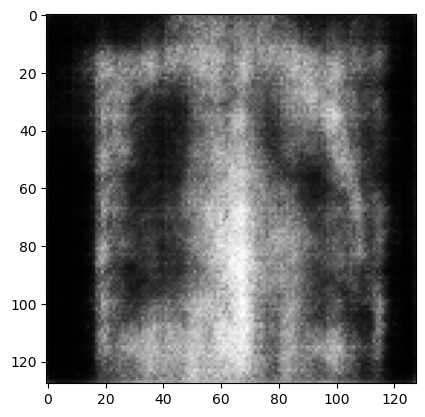

====== Epoch 24 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.9988512396812439, Generator: 6.015642166137695


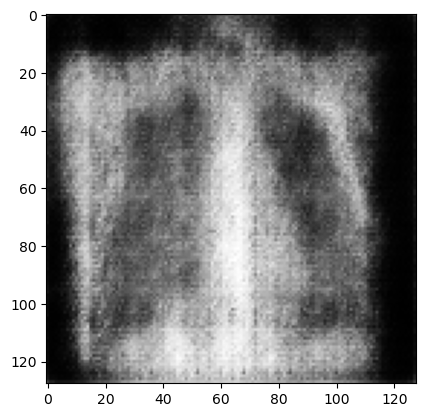

====== Epoch 25 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8223792910575867, Generator: 6.056577205657959


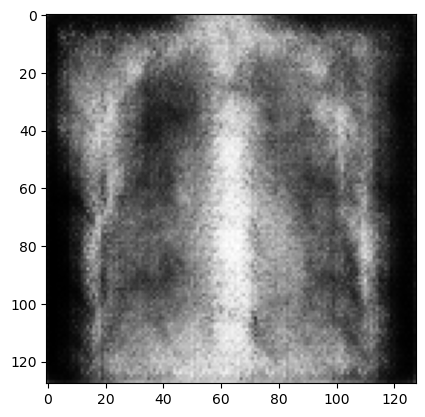

====== Epoch 26 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7420989274978638, Generator: 5.012553691864014


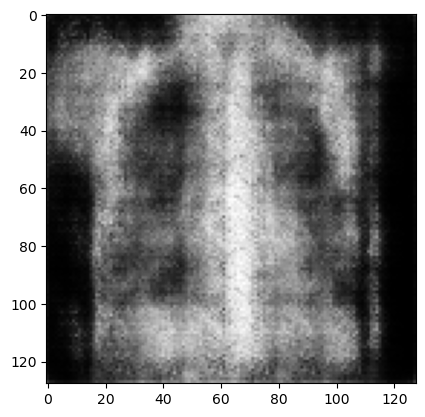

====== Epoch 27 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8538683652877808, Generator: 5.794253349304199


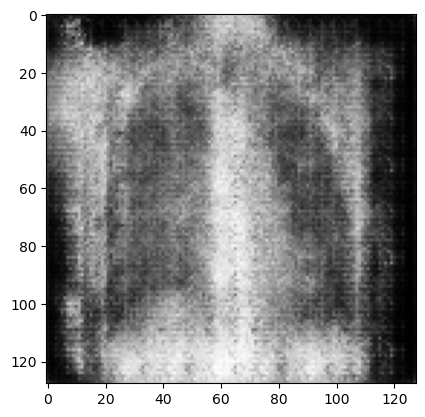

====== Epoch 28 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 1.0036362409591675, Generator: 4.829240798950195


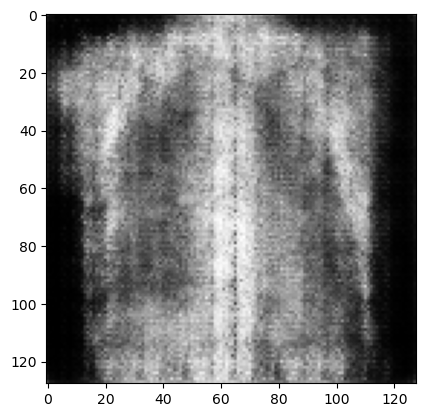

====== Epoch 29 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 1.0164417028427124, Generator: 4.141580104827881


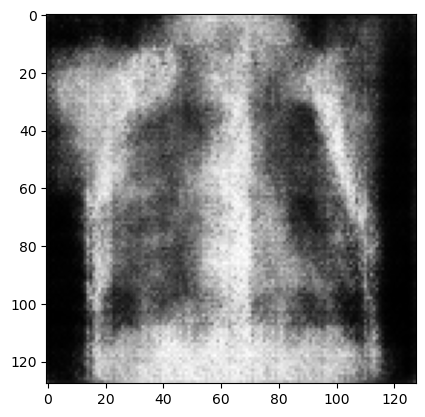

====== Epoch 30 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4727180302143097, Generator: 4.323038578033447


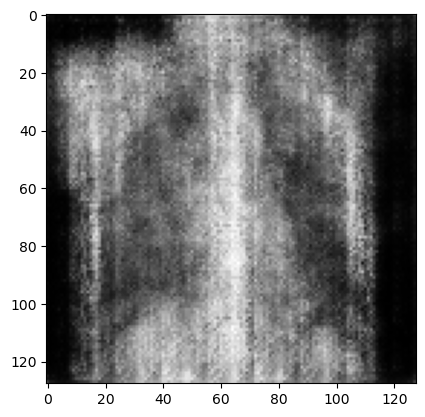

====== Epoch 31 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.9064906239509583, Generator: 5.0076727867126465


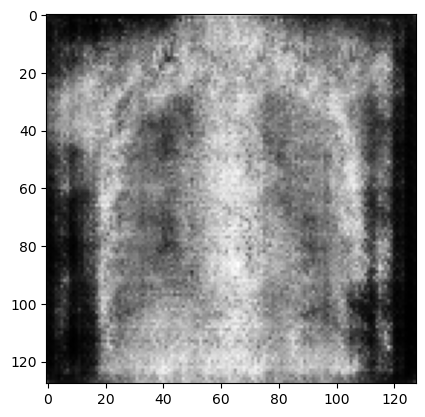

====== Epoch 32 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6048222780227661, Generator: 5.159279823303223


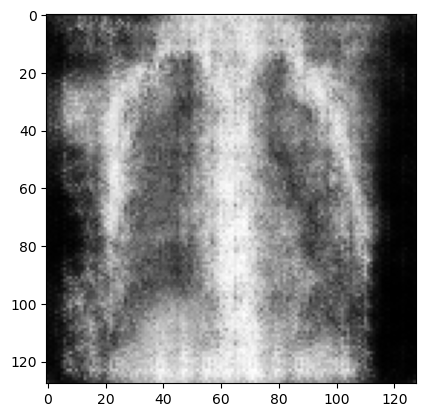

====== Epoch 33 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6193013191223145, Generator: 4.341991424560547


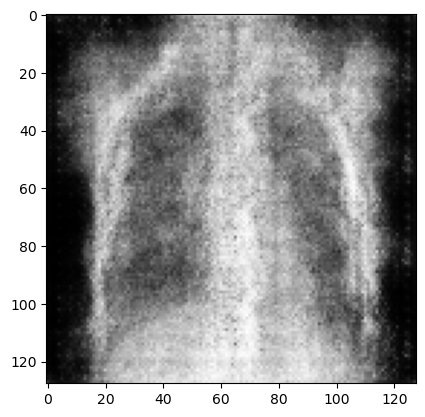

====== Epoch 34 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6414216756820679, Generator: 5.610381603240967


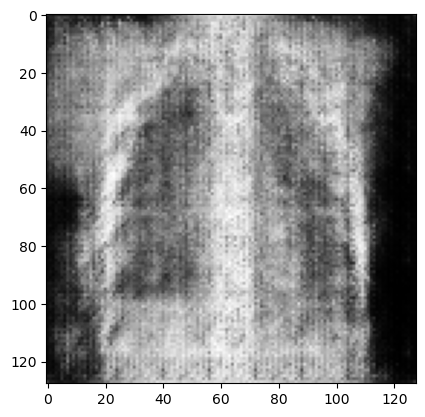

====== Epoch 35 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.47734886407852173, Generator: 4.944904327392578


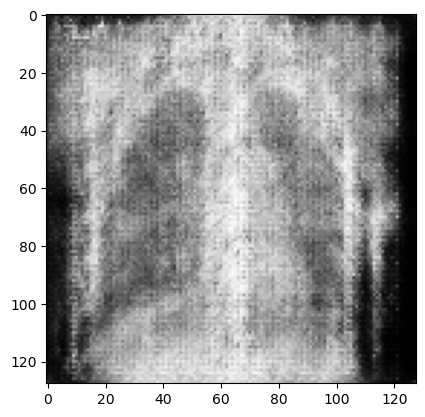

====== Epoch 36 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.36167004704475403, Generator: 4.890727996826172


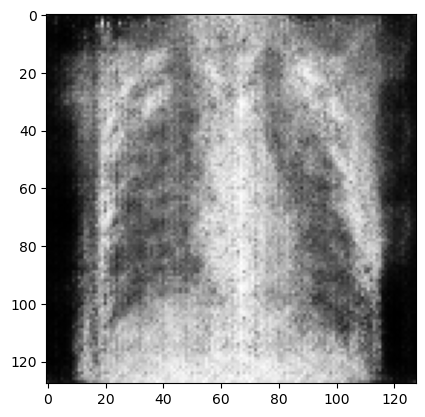

====== Epoch 37 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6422351598739624, Generator: 5.800933361053467


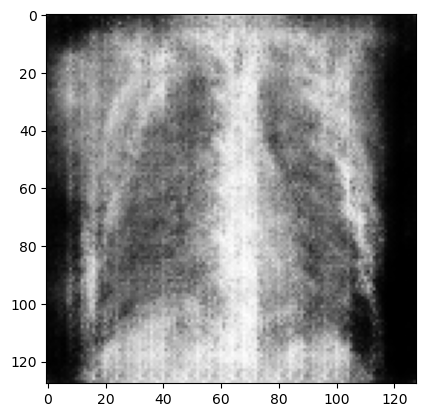

====== Epoch 38 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.789564311504364, Generator: 4.6780195236206055


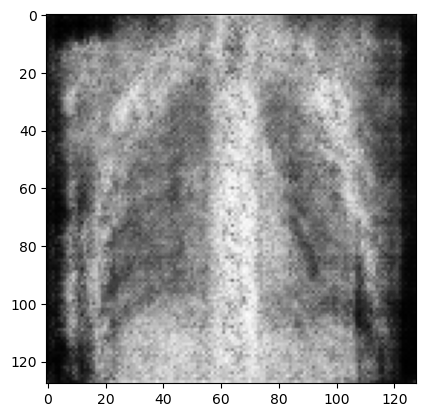

====== Epoch 39 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.595163106918335, Generator: 5.644261837005615


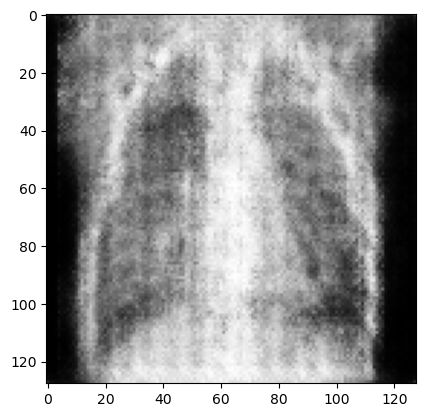

====== Epoch 40 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5943629741668701, Generator: 5.387834072113037


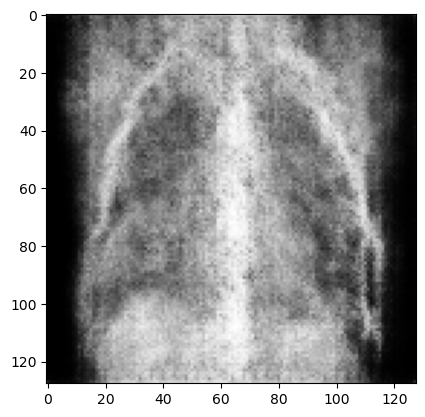

====== Epoch 41 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4653613269329071, Generator: 4.17168664932251


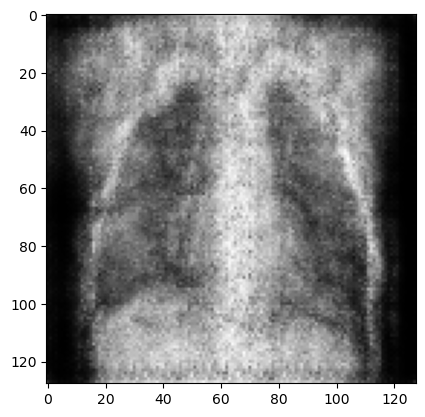

====== Epoch 42 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7718552350997925, Generator: 5.236110687255859


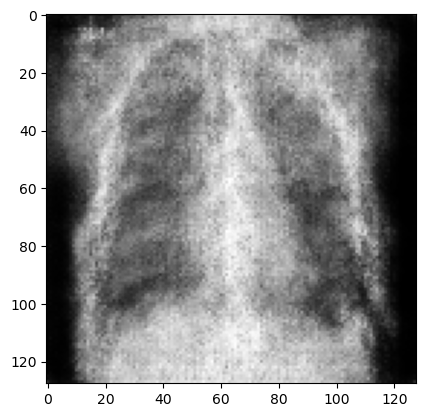

====== Epoch 43 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6142664551734924, Generator: 5.208951950073242


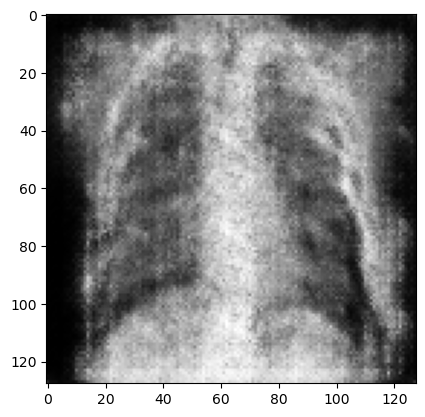

====== Epoch 44 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.43100887537002563, Generator: 4.2540082931518555


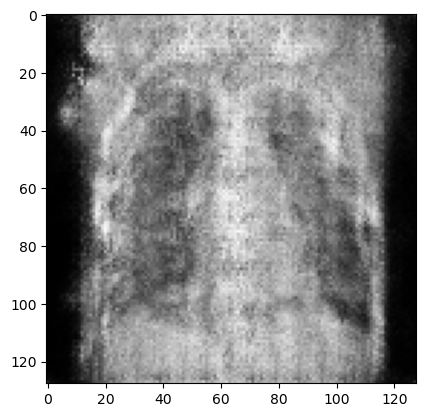

====== Epoch 45 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6366577744483948, Generator: 4.814516544342041


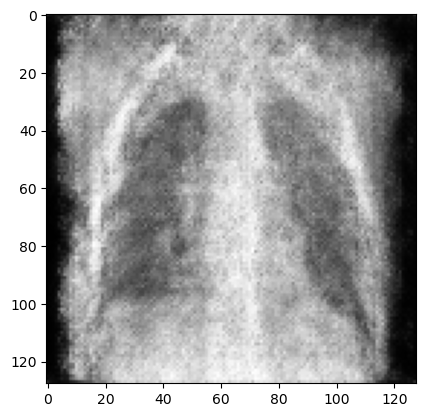

====== Epoch 46 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7039728164672852, Generator: 5.220705032348633


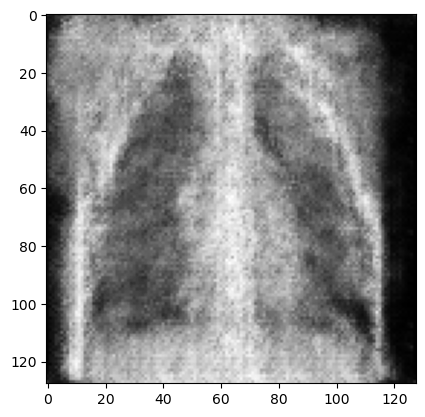

====== Epoch 47 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.41351425647735596, Generator: 4.992260932922363


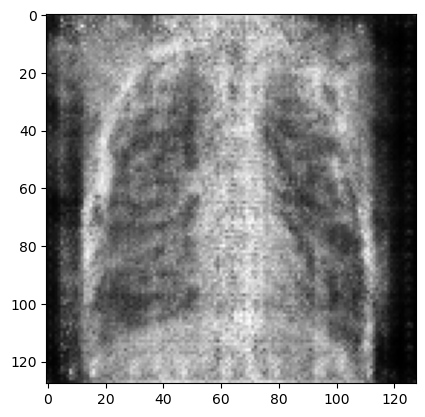

====== Epoch 48 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.538527250289917, Generator: 4.826908588409424


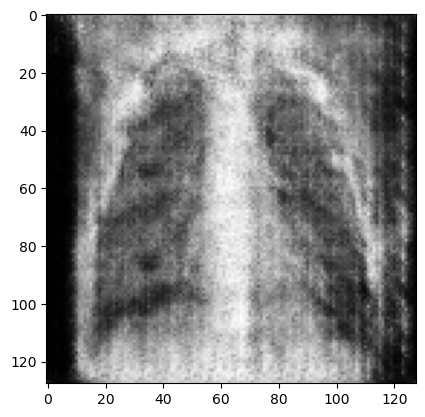

====== Epoch 49 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4866386950016022, Generator: 4.671579360961914


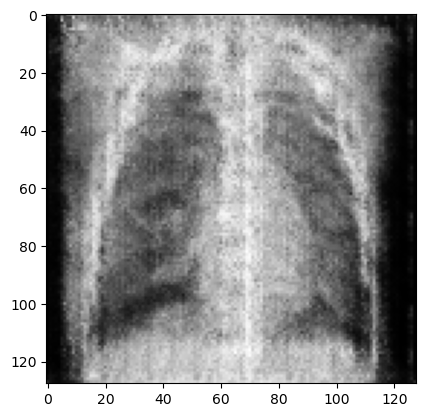

====== Epoch 50 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4385981261730194, Generator: 5.72038459777832


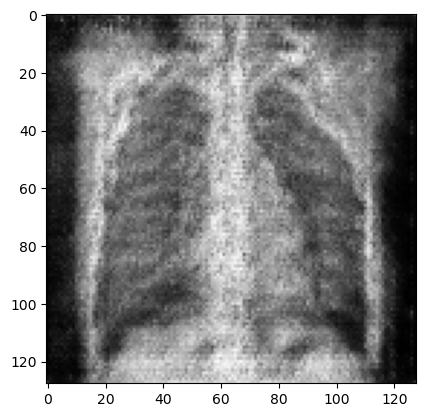

====== Epoch 51 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4989950358867645, Generator: 5.491255760192871


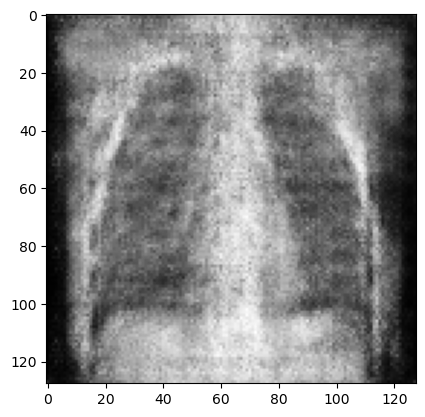

====== Epoch 52 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5511161684989929, Generator: 5.7600789070129395


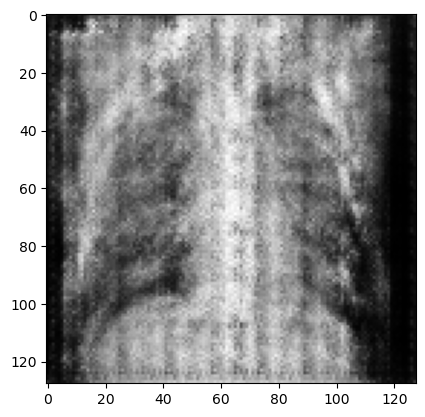

====== Epoch 53 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4681997299194336, Generator: 5.911098957061768


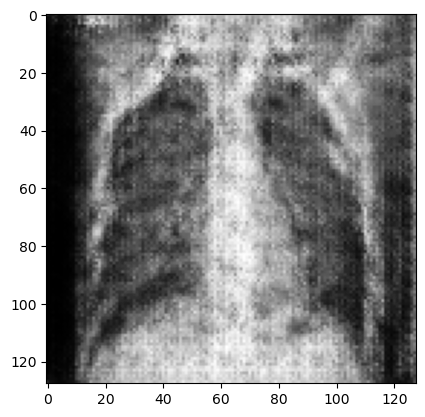

====== Epoch 54 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6096876859664917, Generator: 6.819576740264893


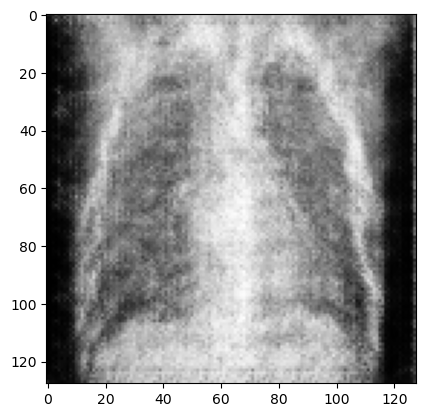

====== Epoch 55 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.29167640209198, Generator: 4.731771469116211


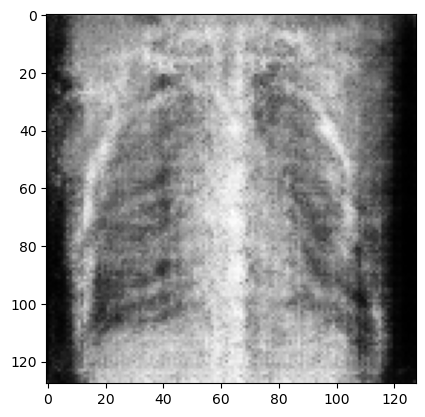

====== Epoch 56 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4368285536766052, Generator: 5.2981181144714355


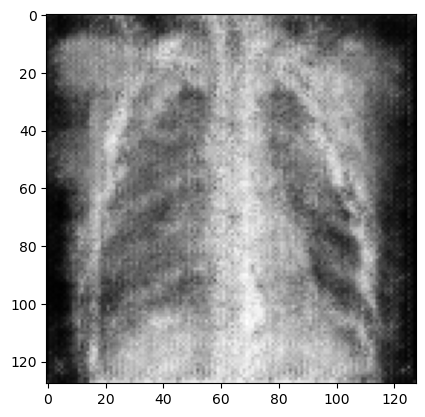

====== Epoch 57 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.534027099609375, Generator: 6.115734577178955


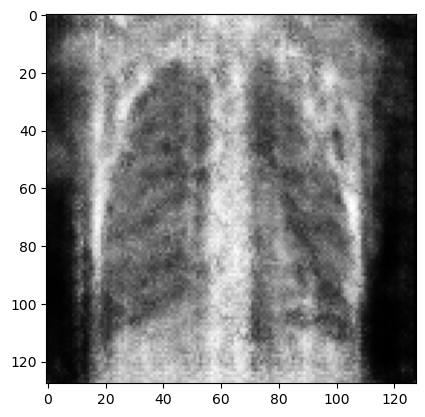

====== Epoch 58 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8804237842559814, Generator: 7.327785968780518


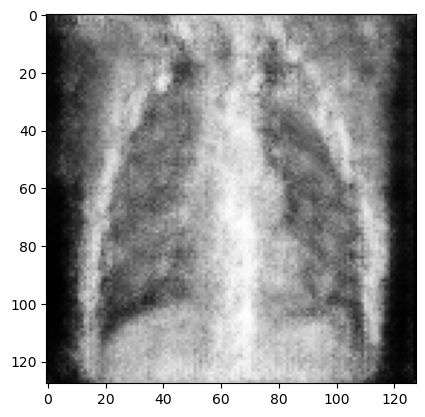

====== Epoch 59 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7184078693389893, Generator: 4.869612693786621


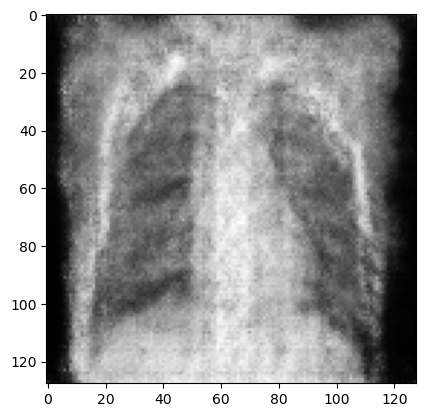

====== Epoch 60 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5040616393089294, Generator: 5.136876583099365


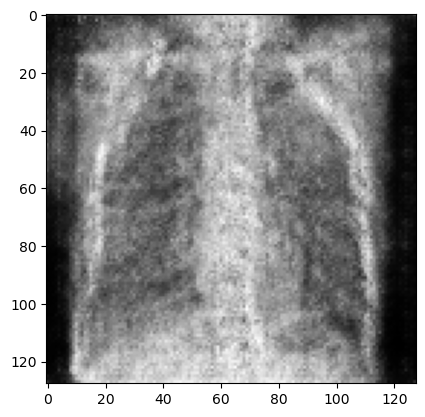

====== Epoch 61 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4772818982601166, Generator: 6.143028736114502


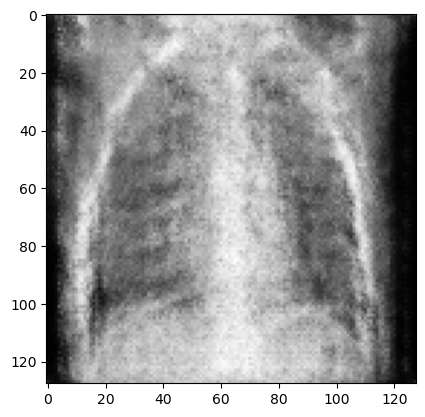

====== Epoch 62 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3351709842681885, Generator: 5.050269603729248


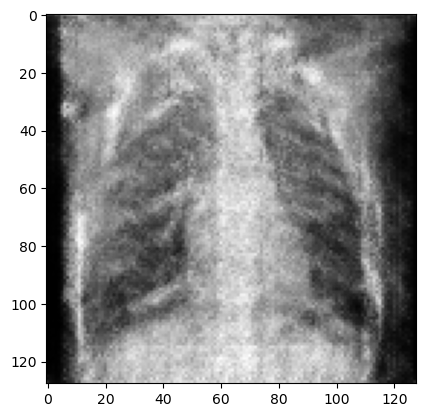

====== Epoch 63 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4324035942554474, Generator: 4.429436206817627


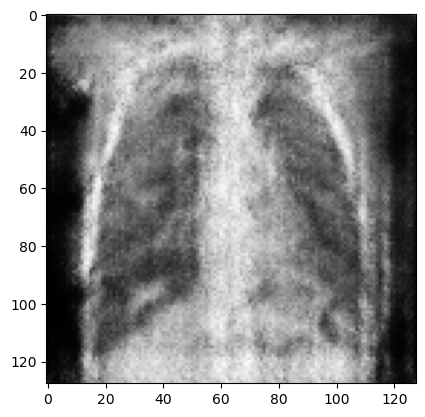

====== Epoch 64 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.9090877175331116, Generator: 5.636415004730225


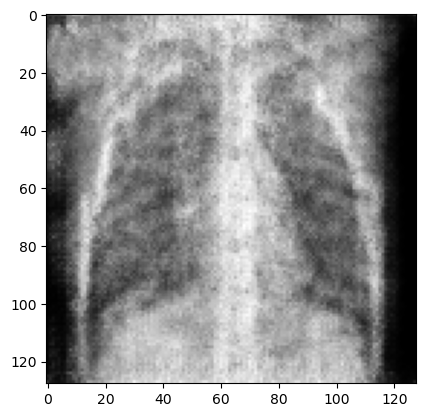

====== Epoch 65 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3827607333660126, Generator: 4.946845531463623


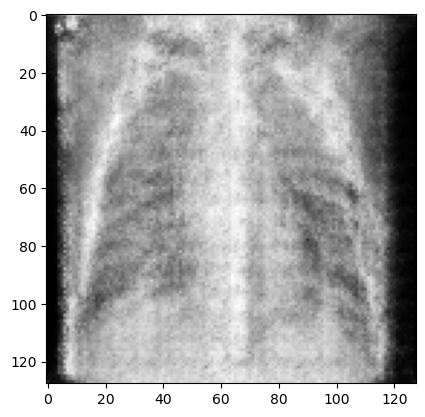

====== Epoch 66 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4158859848976135, Generator: 4.400241851806641


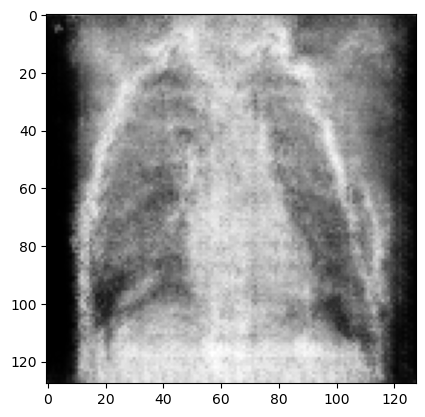

====== Epoch 67 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.41848915815353394, Generator: 5.883978843688965


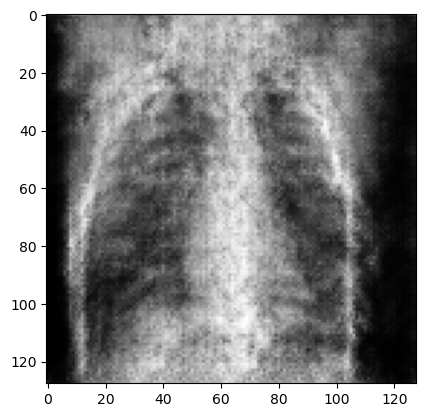

====== Epoch 68 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3413747549057007, Generator: 6.666257858276367


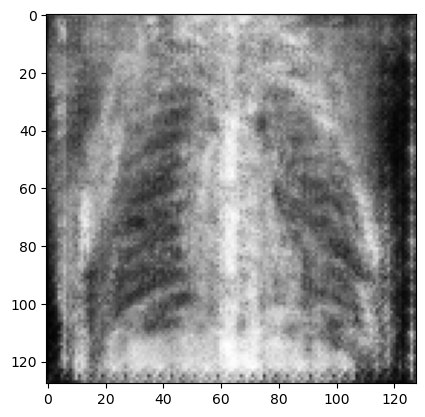

====== Epoch 69 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2806915044784546, Generator: 5.430201053619385


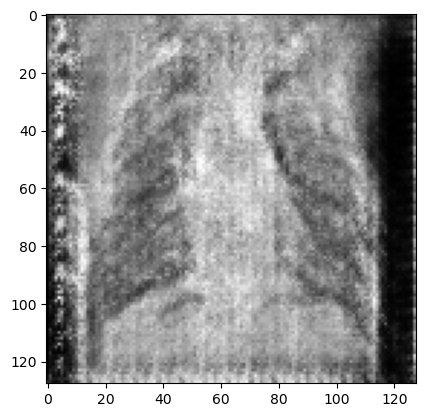

====== Epoch 70 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5370399355888367, Generator: 6.412595272064209


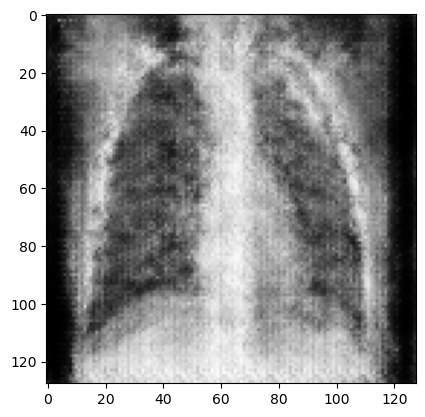

====== Epoch 71 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6728281378746033, Generator: 5.287237644195557


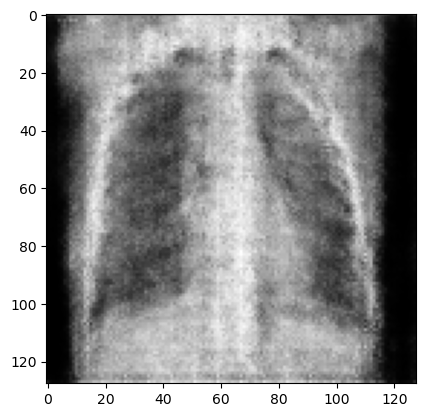

====== Epoch 72 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4703507423400879, Generator: 4.936743259429932


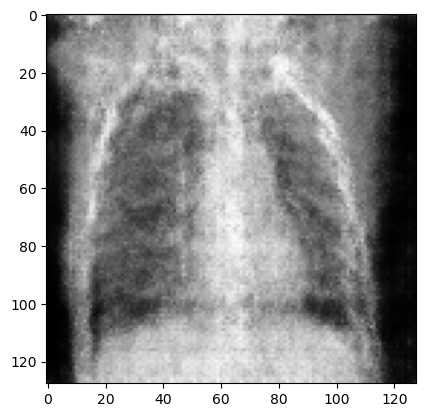

====== Epoch 73 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.47786977887153625, Generator: 6.179564476013184


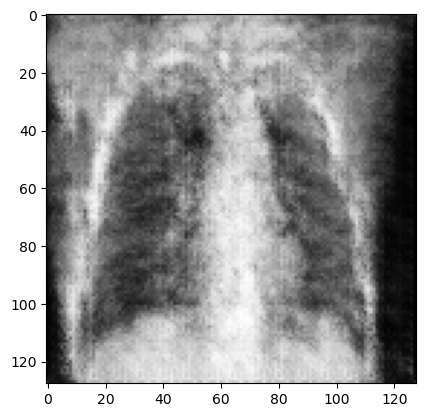

====== Epoch 74 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4801846742630005, Generator: 5.768093109130859


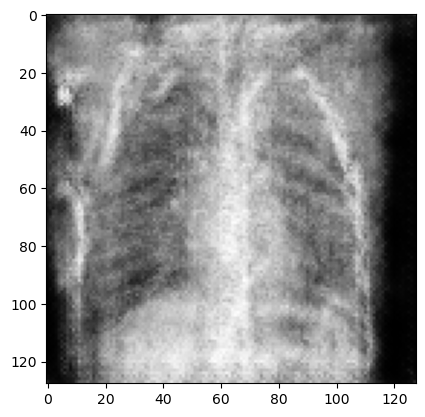

====== Epoch 75 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4521421194076538, Generator: 5.448814392089844


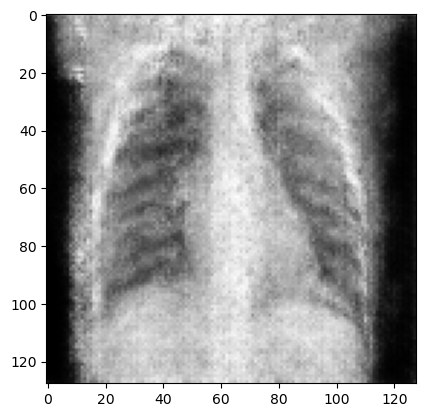

====== Epoch 76 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3341743052005768, Generator: 5.2008161544799805


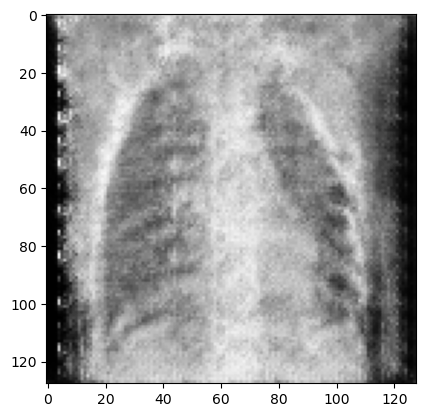

====== Epoch 77 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2824152410030365, Generator: 4.98937463760376


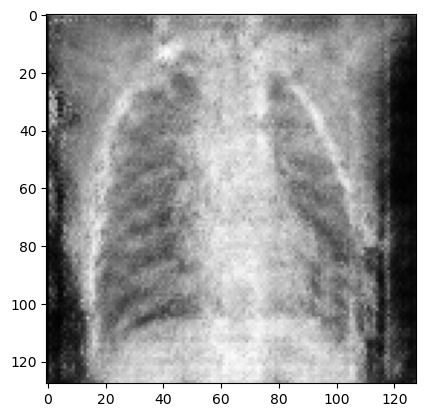

====== Epoch 78 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3393854796886444, Generator: 7.172338485717773


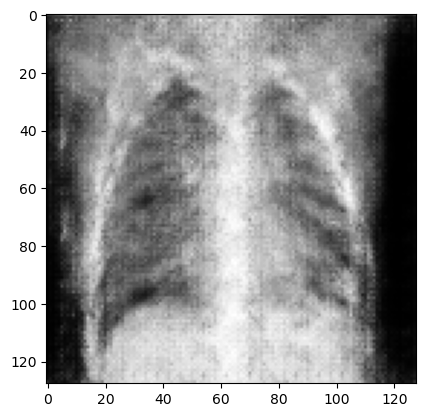

====== Epoch 79 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8174620270729065, Generator: 6.461482048034668


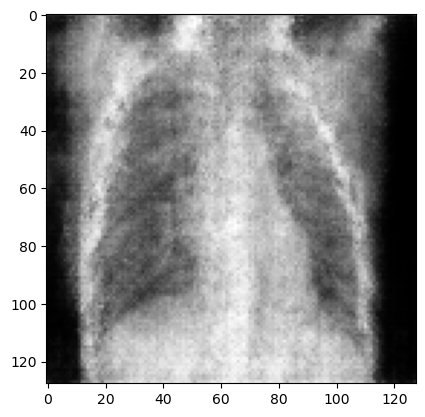

====== Epoch 80 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4232378602027893, Generator: 4.580540180206299


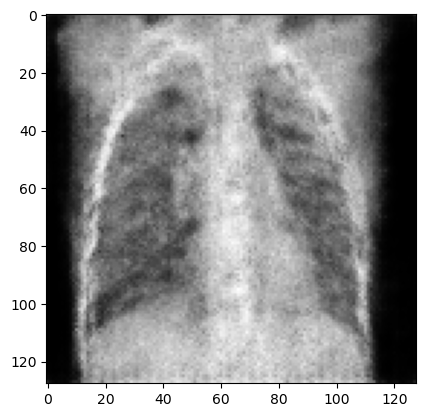

====== Epoch 81 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5383839011192322, Generator: 6.480152606964111


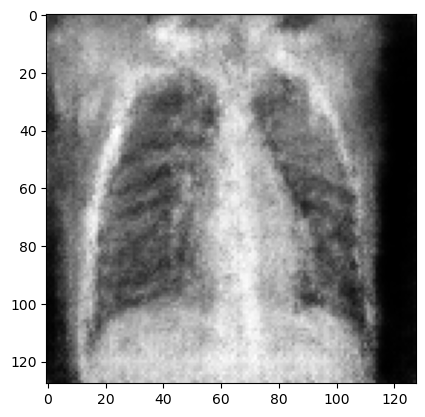

====== Epoch 82 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.47160804271698, Generator: 4.992220878601074


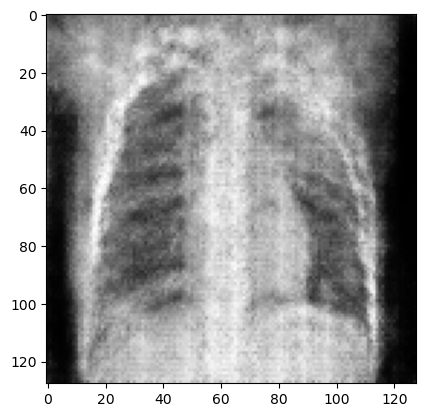

====== Epoch 83 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5228354930877686, Generator: 4.883752822875977


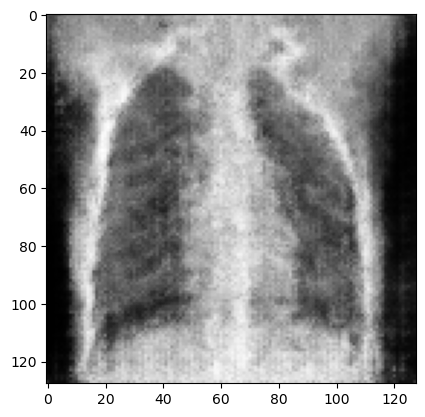

====== Epoch 84 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3481987714767456, Generator: 5.21432638168335


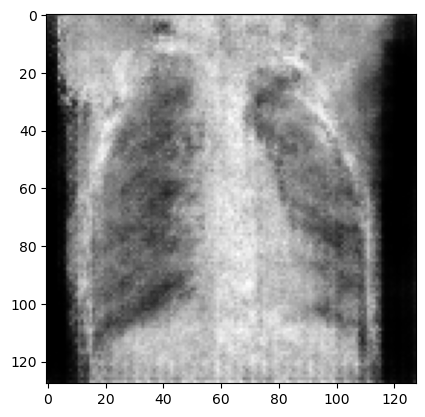

====== Epoch 85 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.42136645317077637, Generator: 6.145907878875732


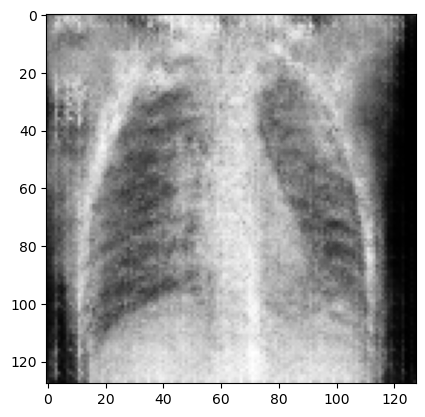

====== Epoch 86 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.42402637004852295, Generator: 5.9779791831970215


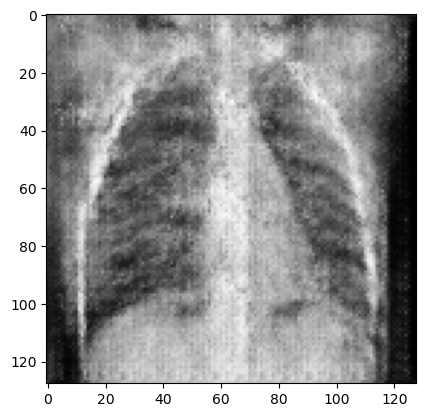

====== Epoch 87 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4757777452468872, Generator: 6.429975986480713


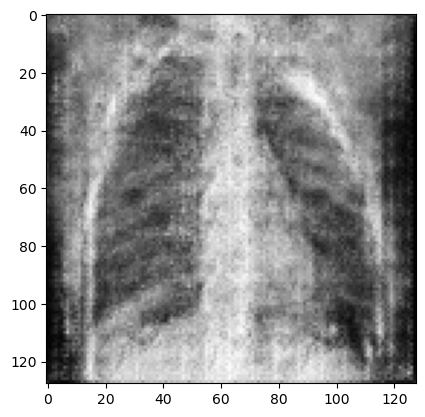

====== Epoch 88 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3278002142906189, Generator: 4.53502082824707


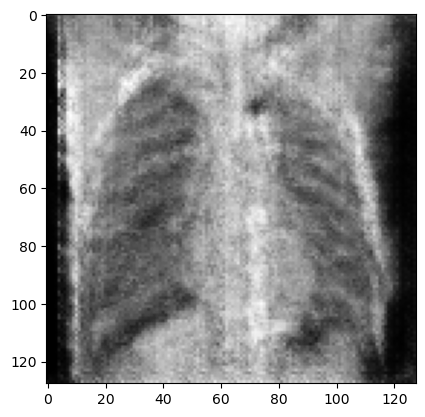

====== Epoch 89 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.22085410356521606, Generator: 4.8375372886657715


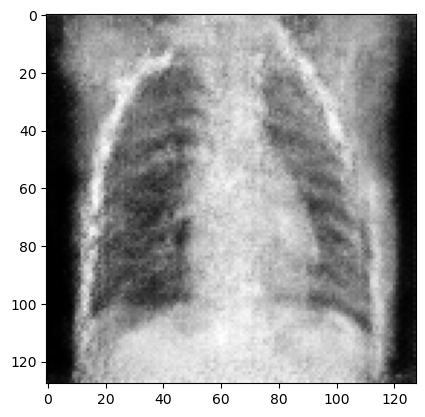

====== Epoch 90 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8986132144927979, Generator: 7.2133636474609375


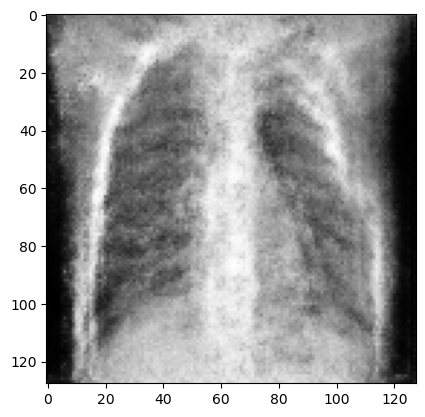

====== Epoch 91 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3182184100151062, Generator: 4.041821002960205


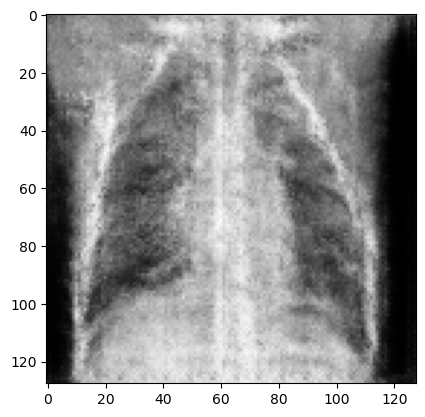

====== Epoch 92 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5795909762382507, Generator: 7.653968811035156


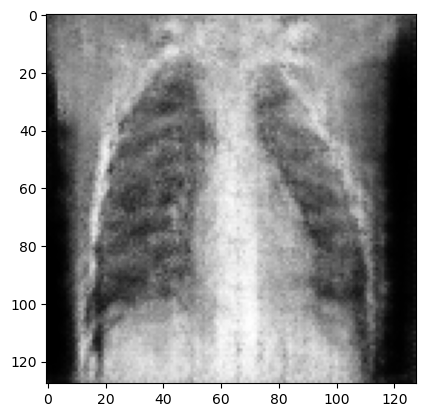

====== Epoch 93 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2581561803817749, Generator: 3.756998300552368


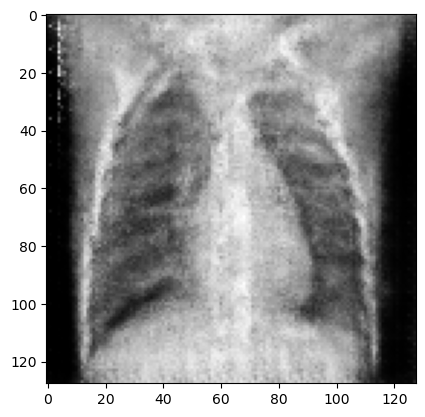

====== Epoch 94 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2701198160648346, Generator: 5.848427772521973


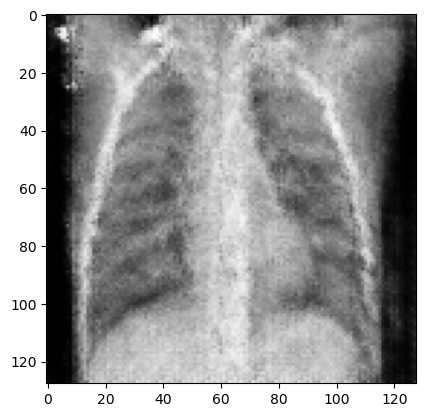

====== Epoch 95 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.18198354542255402, Generator: 6.276544570922852


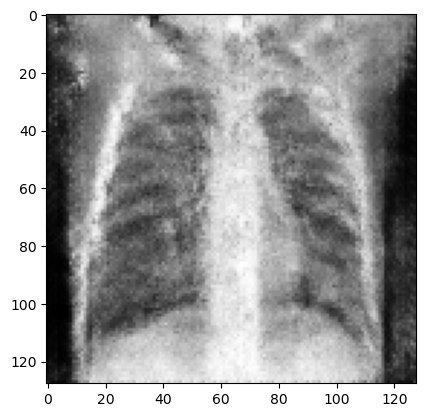

====== Epoch 96 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.1690623164176941, Generator: 4.51412296295166


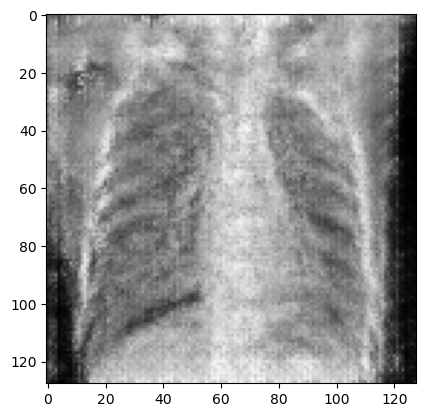

====== Epoch 97 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8842296600341797, Generator: 6.224350452423096


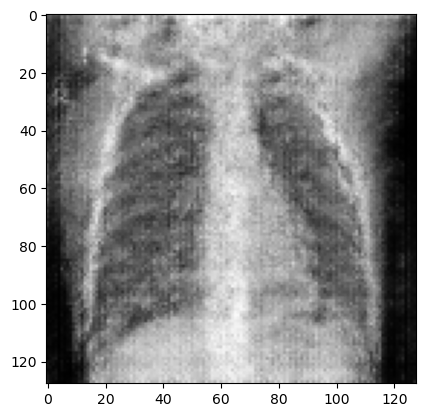

====== Epoch 98 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.305109441280365, Generator: 5.61719274520874


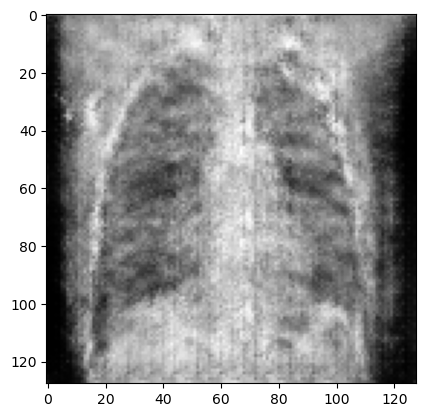

====== Epoch 99 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.28795763850212097, Generator: 5.258551597595215


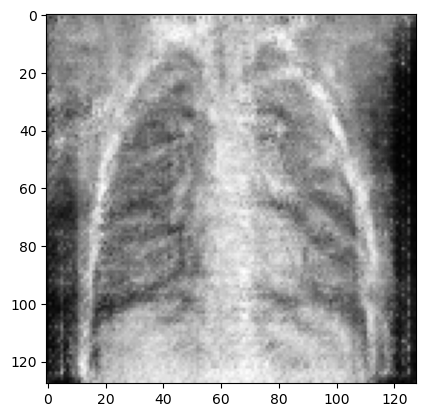

====== Epoch 100 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.27688169479370117, Generator: 5.735697269439697


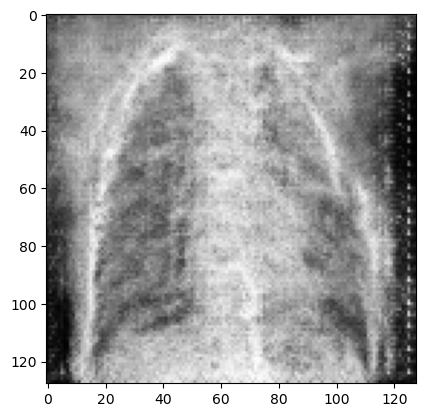

====== Epoch 101 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.36810916662216187, Generator: 5.523807048797607


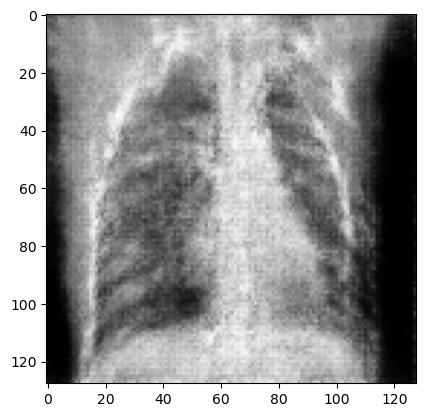

====== Epoch 102 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.25346609950065613, Generator: 5.85206937789917


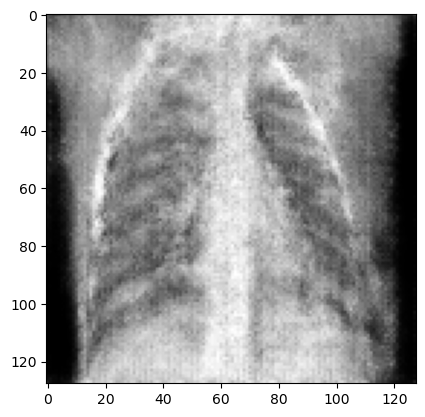

====== Epoch 103 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2421928495168686, Generator: 6.371801376342773


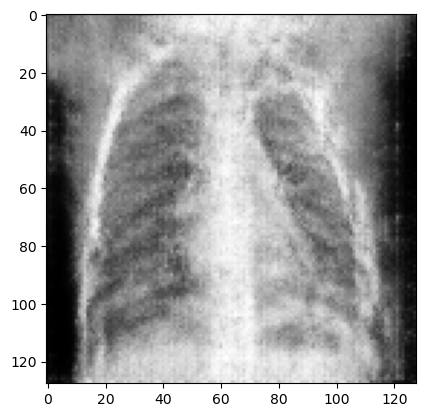

====== Epoch 104 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.17572757601737976, Generator: 4.911571979522705


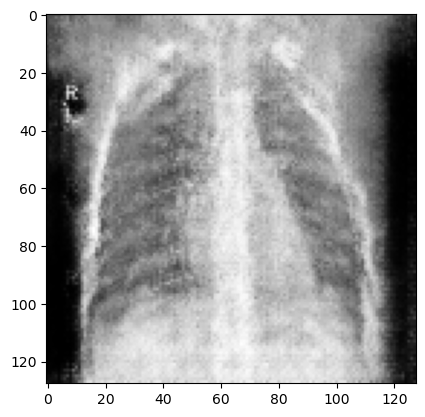

====== Epoch 105 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.34802448749542236, Generator: 5.273880481719971


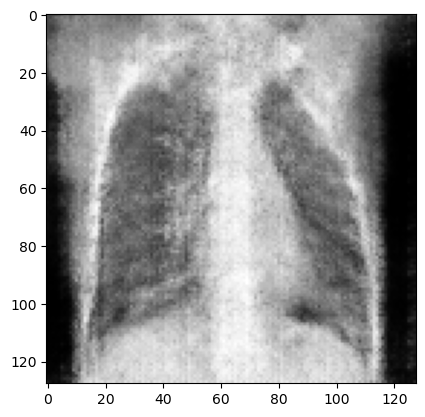

====== Epoch 106 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2316398024559021, Generator: 5.113964557647705


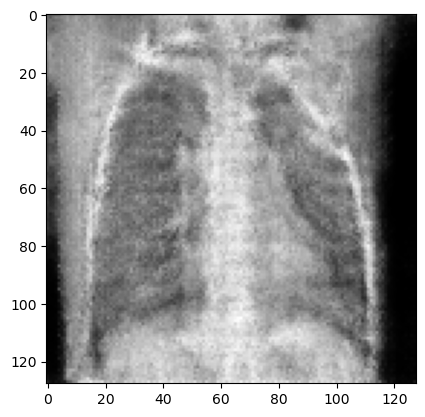

====== Epoch 107 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4377228319644928, Generator: 6.350133895874023


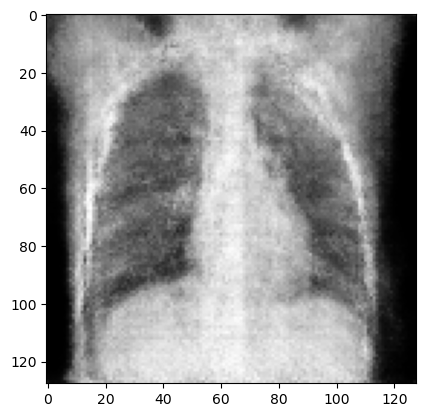

====== Epoch 108 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4369436502456665, Generator: 5.224393367767334


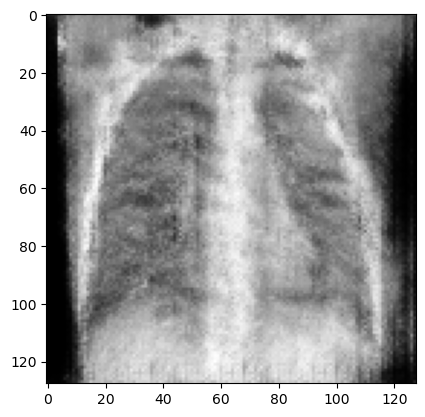

====== Epoch 109 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.14735062420368195, Generator: 5.889206886291504


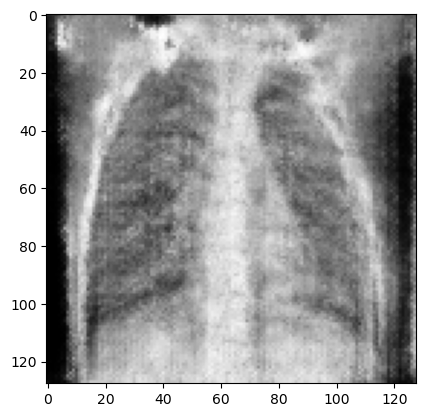

====== Epoch 110 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.163679838180542, Generator: 5.227011203765869


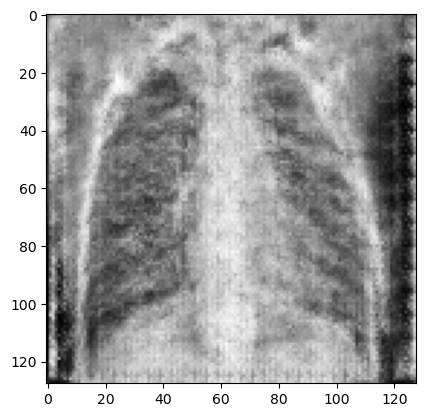

====== Epoch 111 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.13546252250671387, Generator: 5.985782146453857


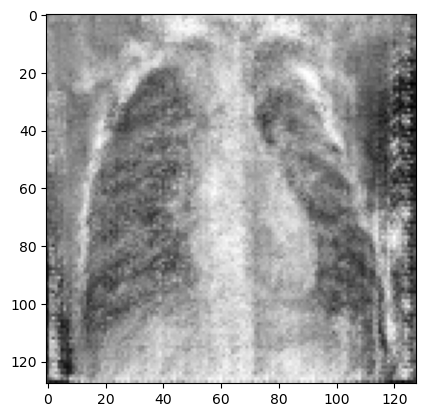

====== Epoch 112 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.29599297046661377, Generator: 8.155782699584961


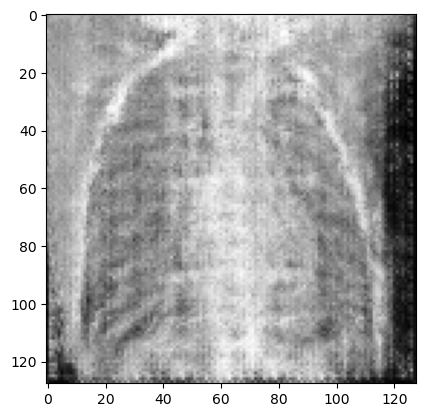

====== Epoch 113 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.18738247454166412, Generator: 7.3514251708984375


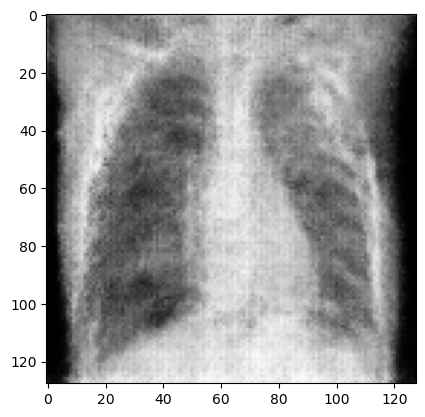

====== Epoch 114 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5737684965133667, Generator: 7.76781702041626


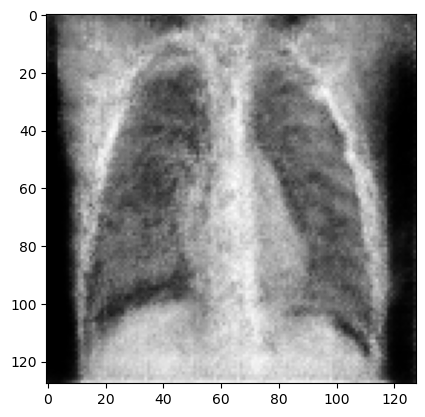

====== Epoch 115 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.27445563673973083, Generator: 7.168069839477539


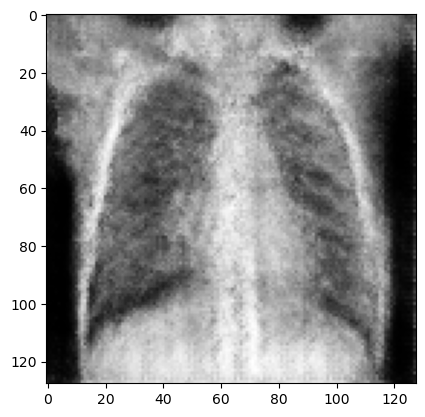

====== Epoch 116 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3483245074748993, Generator: 8.156210899353027


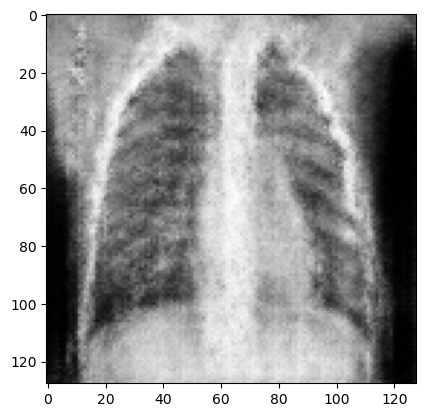

====== Epoch 117 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.12385293841362, Generator: 6.693414211273193


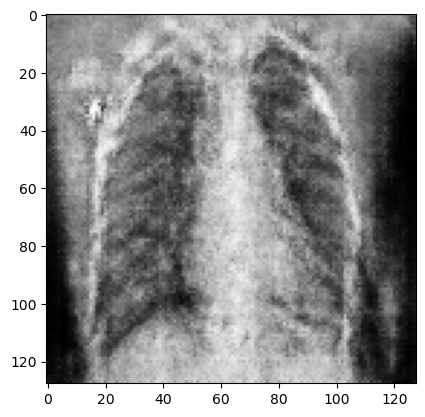

====== Epoch 118 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.25082623958587646, Generator: 8.855591773986816


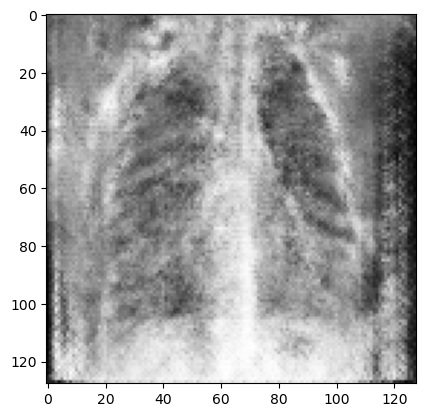

====== Epoch 119 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3263186812400818, Generator: 6.404866695404053


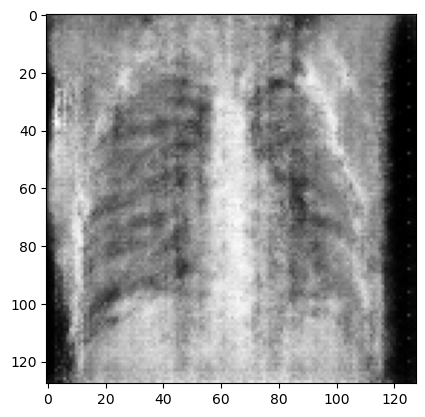

====== Epoch 120 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.49346351623535156, Generator: 8.100191116333008


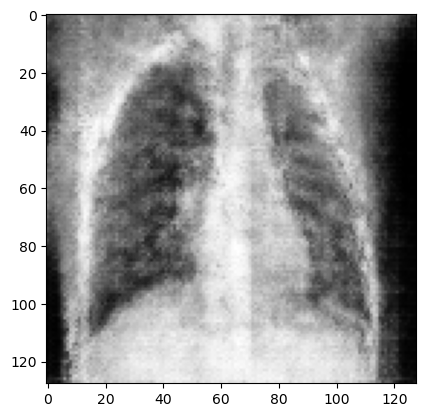

====== Epoch 121 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.33276236057281494, Generator: 5.676429271697998


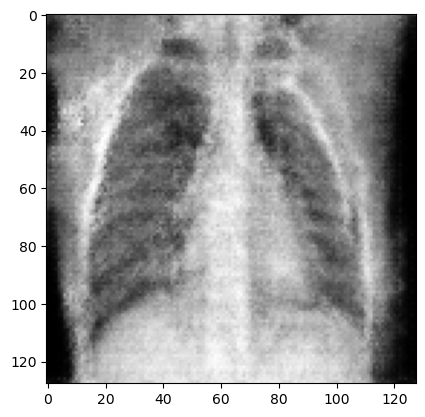

====== Epoch 122 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.36084234714508057, Generator: 8.702495574951172


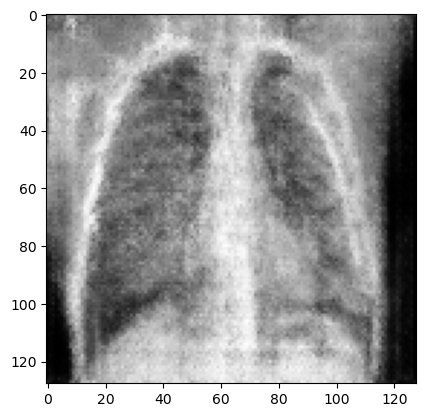

====== Epoch 123 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.31845834851264954, Generator: 6.017819881439209


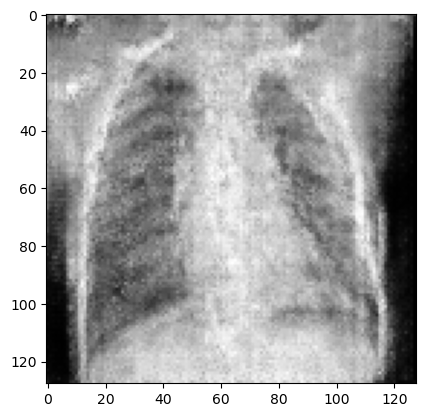

====== Epoch 124 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.36071649193763733, Generator: 7.77966833114624


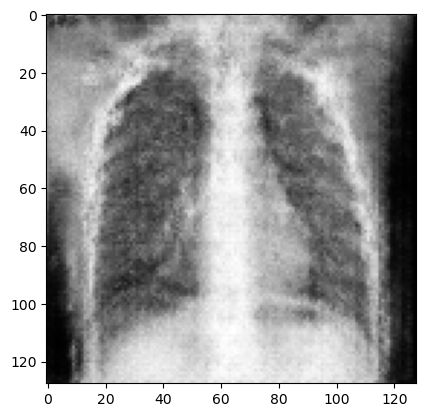

====== Epoch 125 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3070327043533325, Generator: 8.032821655273438


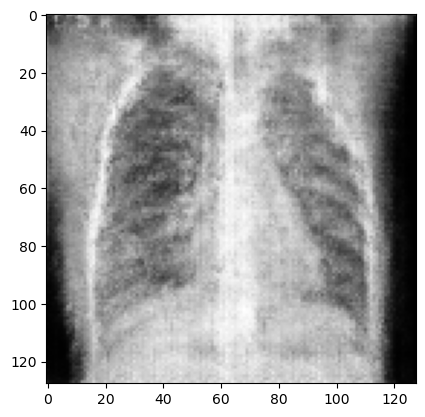

====== Epoch 126 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.523033857345581, Generator: 8.619494438171387


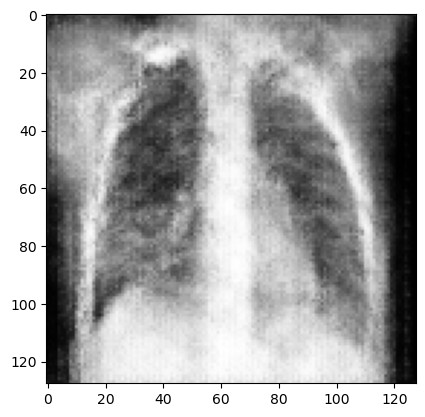

====== Epoch 127 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.38352498412132263, Generator: 7.677248477935791


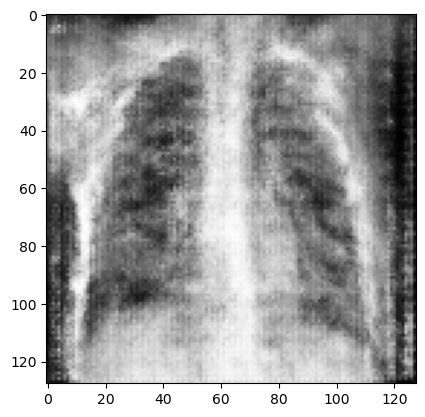

====== Epoch 128 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3142613172531128, Generator: 6.843560695648193


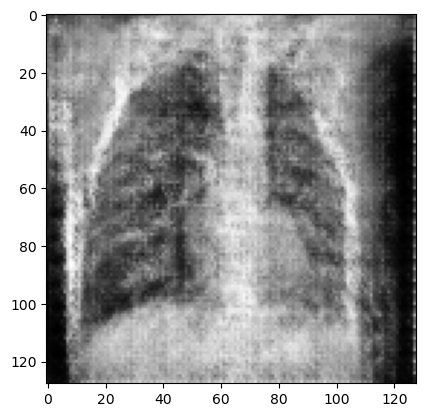

====== Epoch 129 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.1759505718946457, Generator: 7.301839351654053


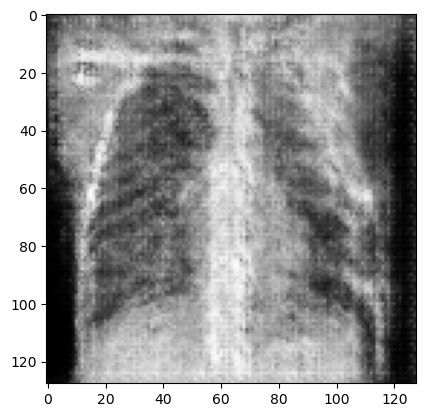

====== Epoch 130 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.19817185401916504, Generator: 5.823389053344727


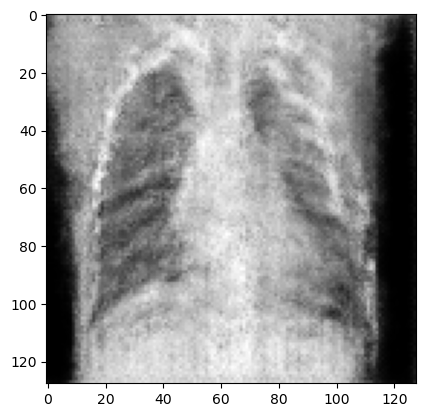

====== Epoch 131 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3880016505718231, Generator: 8.141119003295898


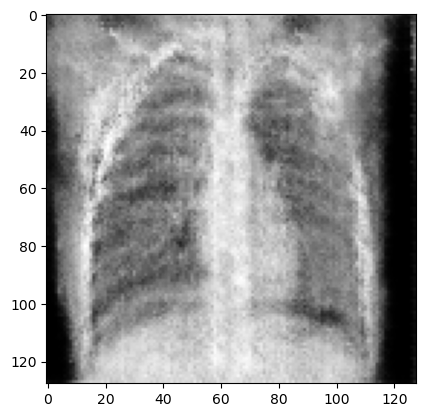

====== Epoch 132 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3517009913921356, Generator: 7.327062606811523


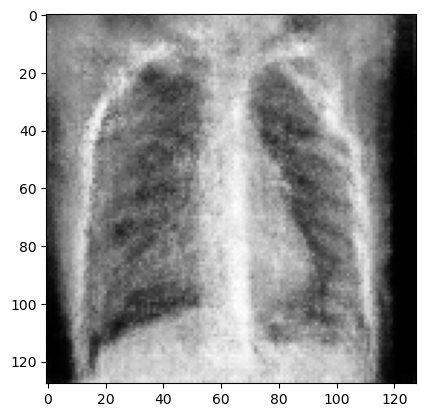

====== Epoch 133 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.21327723562717438, Generator: 5.894562721252441


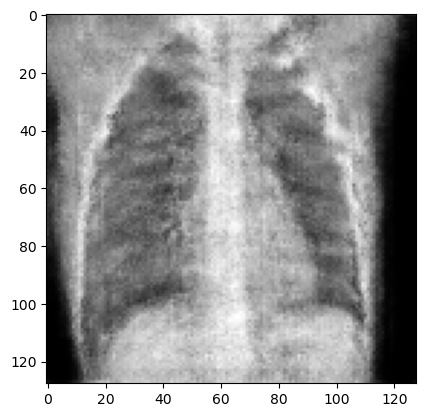

====== Epoch 134 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.33181941509246826, Generator: 7.547501564025879


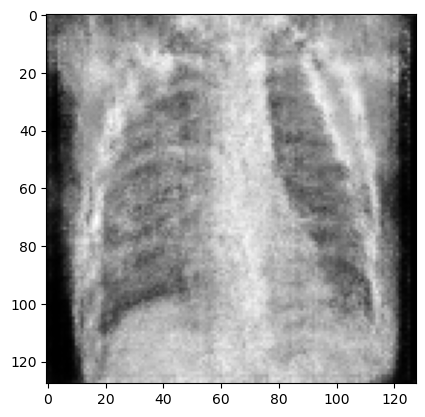

====== Epoch 135 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.21169370412826538, Generator: 8.302814483642578


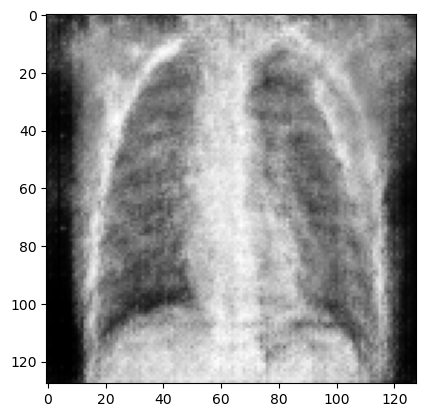

====== Epoch 136 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.18034549057483673, Generator: 8.552675247192383


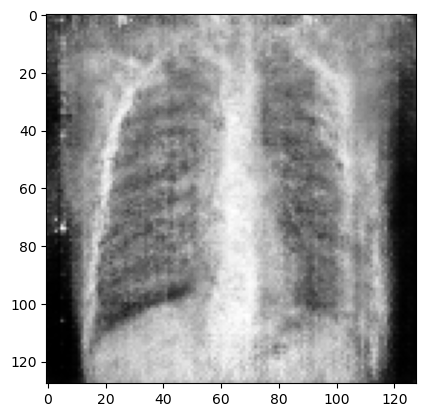

====== Epoch 137 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.08196080476045609, Generator: 5.899778366088867


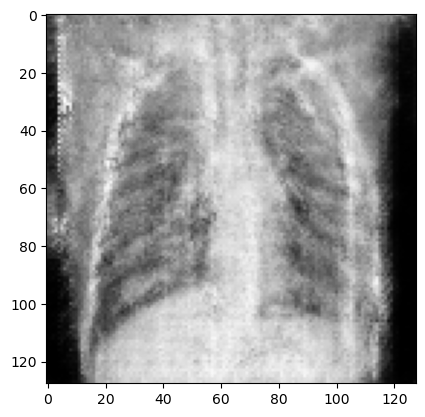

====== Epoch 138 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.19632765650749207, Generator: 8.00415325164795


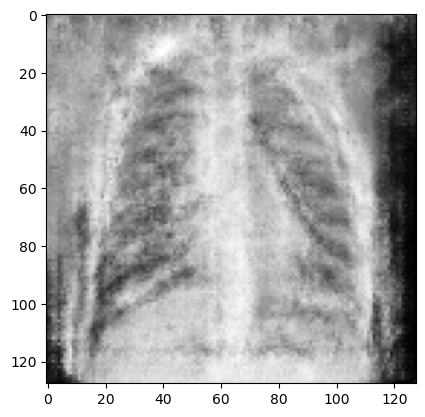

====== Epoch 139 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4342521131038666, Generator: 9.422797203063965


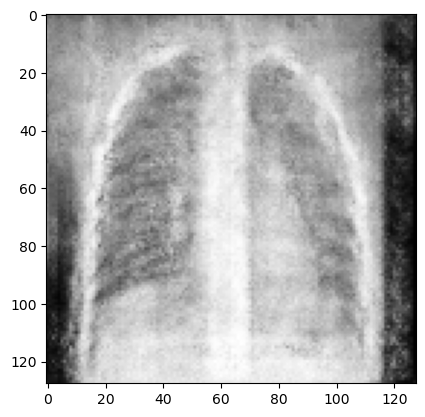

====== Epoch 140 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3944016098976135, Generator: 7.526588439941406


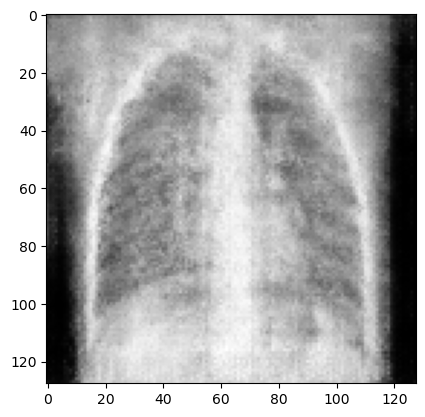

====== Epoch 141 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3742440938949585, Generator: 7.029748439788818


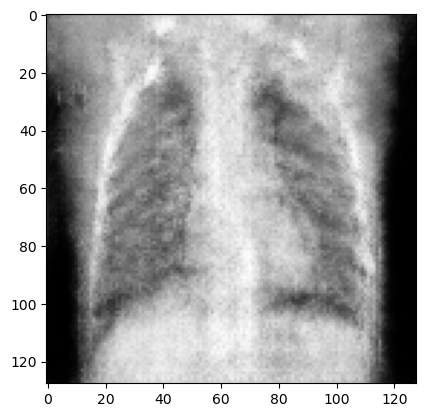

====== Epoch 142 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2956165075302124, Generator: 6.782967567443848


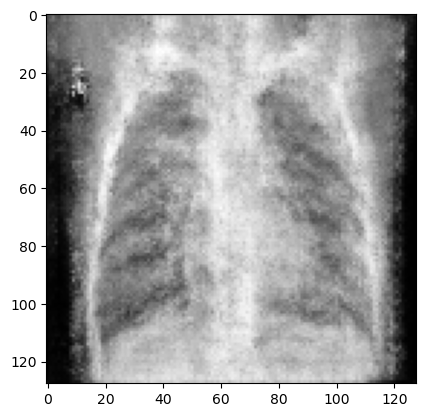

====== Epoch 143 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.30651408433914185, Generator: 6.830209732055664


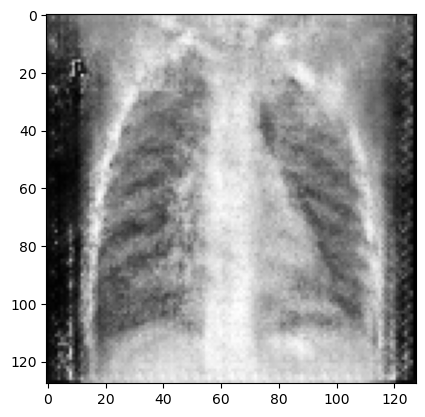

====== Epoch 144 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3588995039463043, Generator: 6.303503036499023


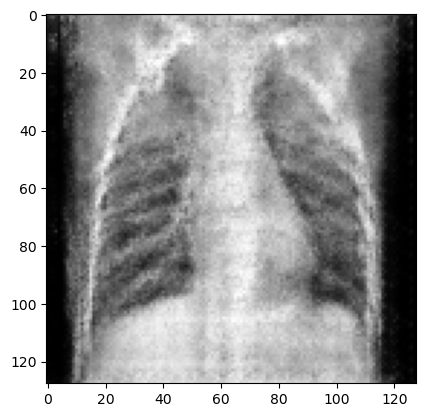

====== Epoch 145 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.21455593407154083, Generator: 6.810034275054932


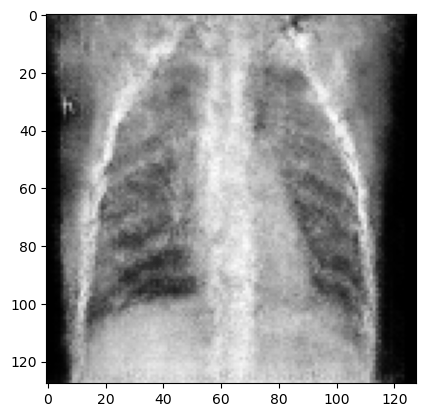

====== Epoch 146 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.16929911077022552, Generator: 7.2312188148498535


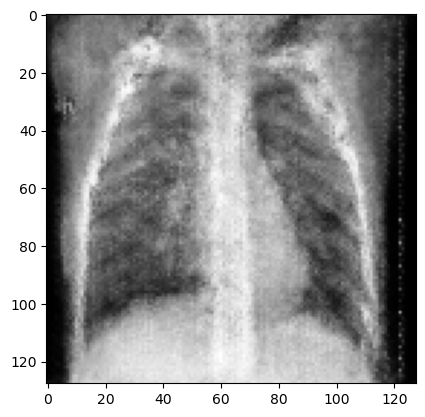

====== Epoch 147 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3667362928390503, Generator: 7.583112716674805


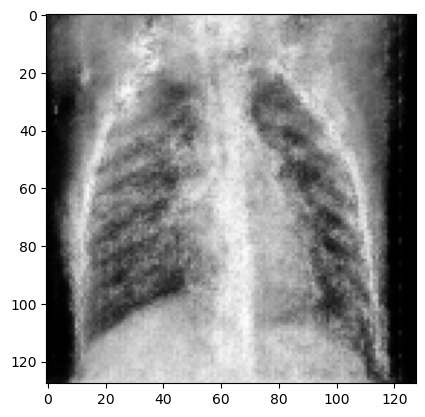

====== Epoch 148 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.527444064617157, Generator: 8.392769813537598


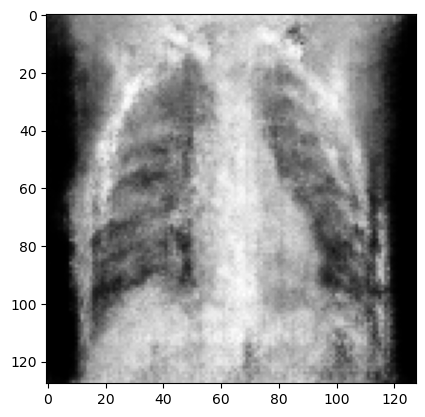

====== Epoch 149 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.39622974395751953, Generator: 7.32419490814209


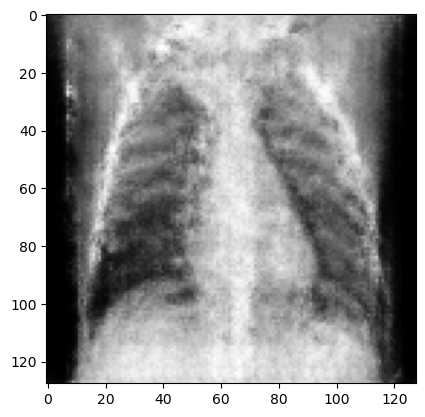

====== Epoch 150 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.33396977186203003, Generator: 7.070326805114746


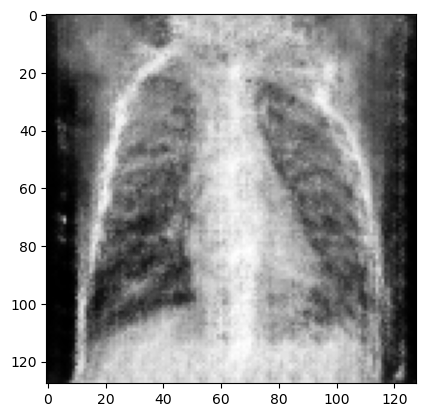

====== Epoch 151 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4268663823604584, Generator: 5.444547176361084


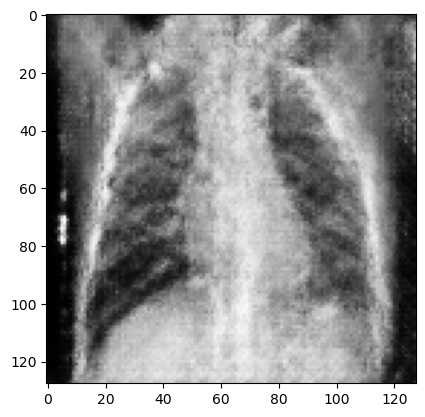

====== Epoch 152 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.27938786149024963, Generator: 7.138254642486572


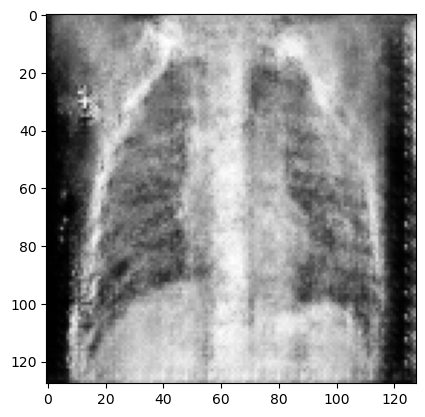

====== Epoch 153 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4714025855064392, Generator: 7.00695276260376


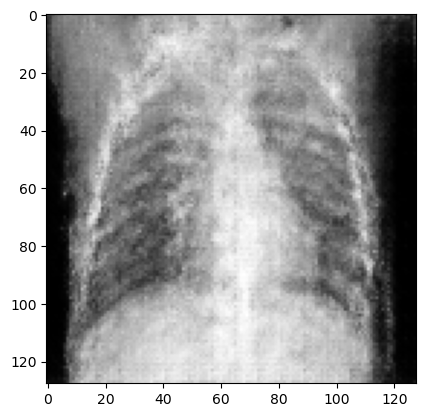

====== Epoch 154 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.46749719977378845, Generator: 7.511148452758789


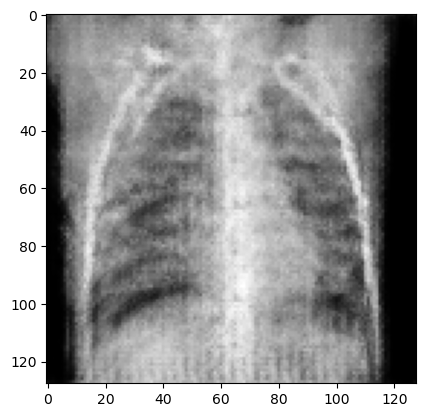

====== Epoch 155 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2695794105529785, Generator: 6.5673112869262695


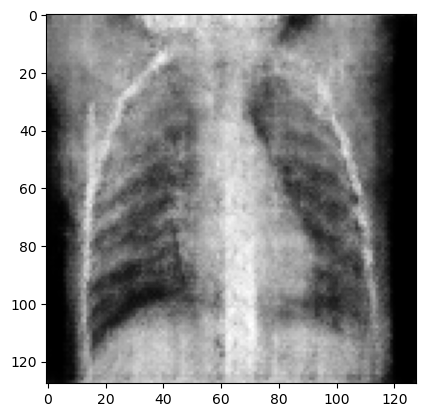

====== Epoch 156 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.12942928075790405, Generator: 5.1515655517578125


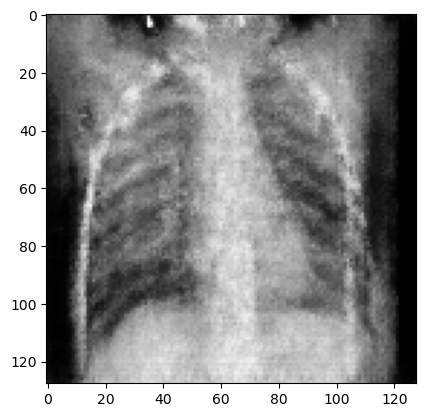

====== Epoch 157 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.38353943824768066, Generator: 11.711995124816895


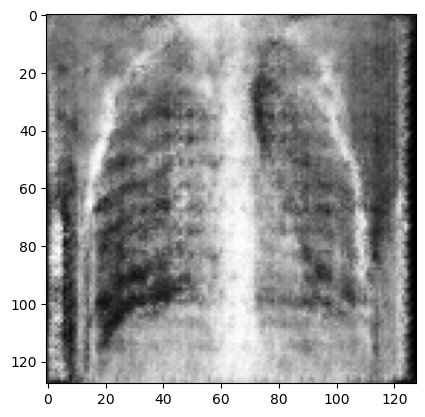

====== Epoch 158 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.29560863971710205, Generator: 6.440041542053223


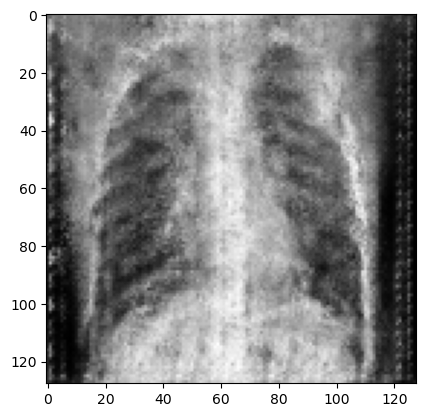

====== Epoch 159 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.7413510680198669, Generator: 8.795381546020508


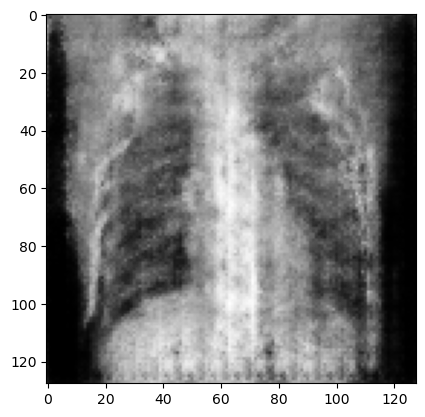

====== Epoch 160 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.28193074464797974, Generator: 5.441434383392334


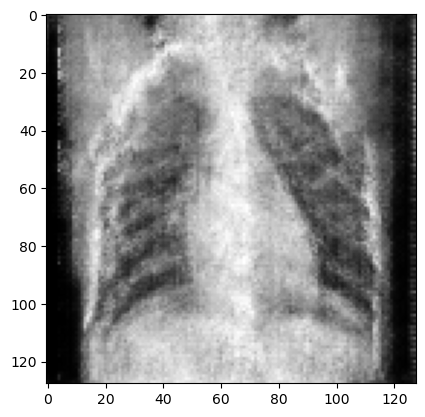

====== Epoch 161 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.29133808612823486, Generator: 7.533476829528809


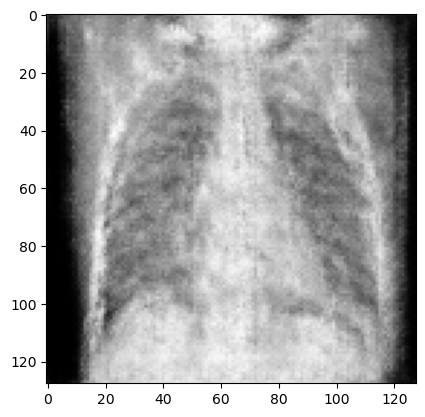

====== Epoch 162 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.17786549031734467, Generator: 6.462998390197754


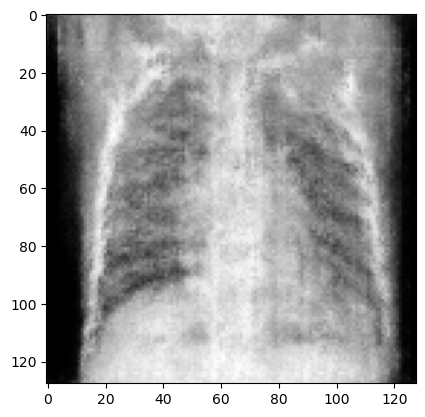

====== Epoch 163 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3290090560913086, Generator: 7.415769100189209


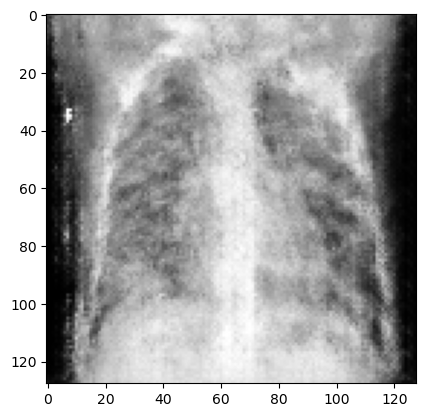

====== Epoch 164 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.26025402545928955, Generator: 7.814877986907959


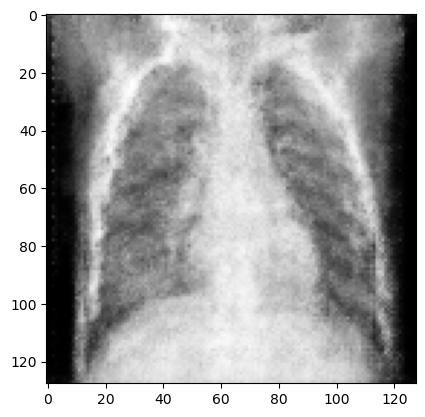

====== Epoch 165 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.17767027020454407, Generator: 4.85923957824707


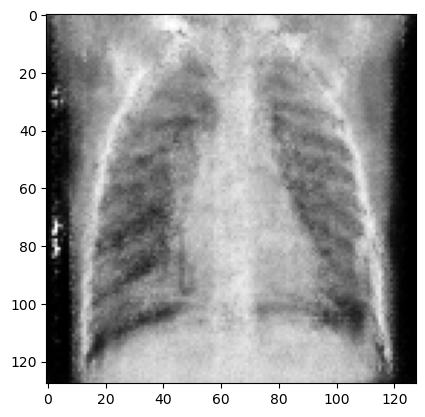

====== Epoch 166 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.13020280003547668, Generator: 5.3125762939453125


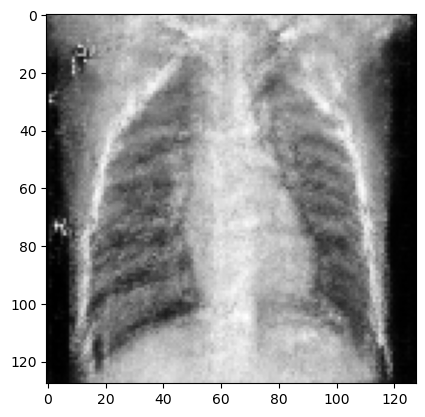

====== Epoch 167 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.2156449258327484, Generator: 8.616497039794922


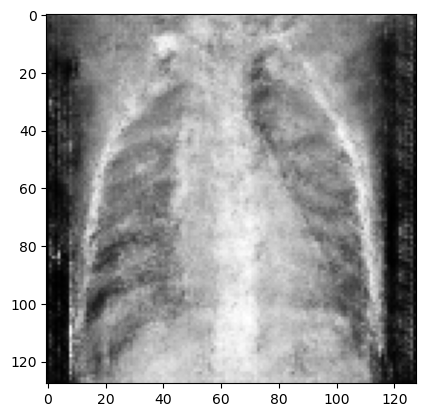

====== Epoch 168 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3220694959163666, Generator: 6.155984878540039


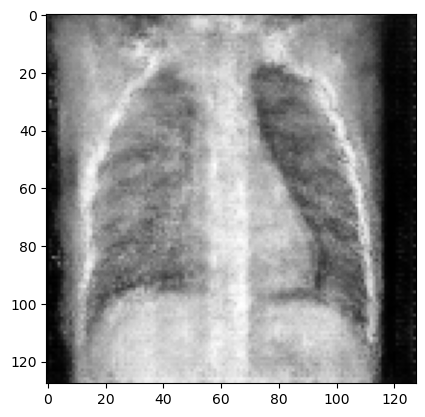

====== Epoch 169 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3247857391834259, Generator: 10.07797622680664


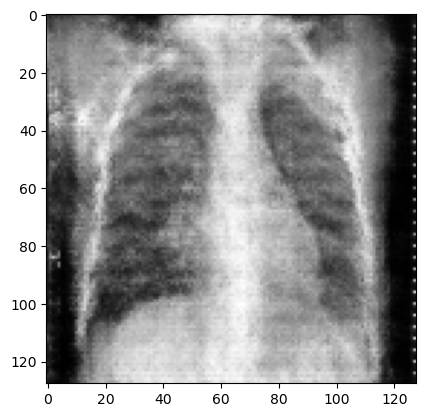

====== Epoch 170 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.21197479963302612, Generator: 9.327496528625488


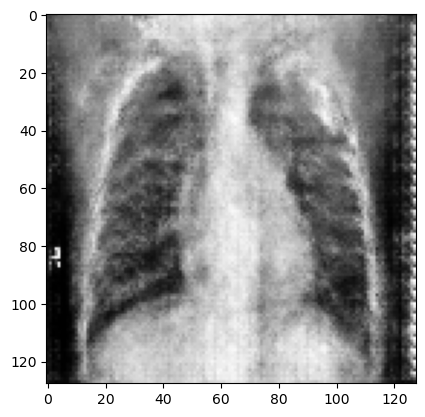

====== Epoch 171 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.05917682126164436, Generator: 5.950588703155518


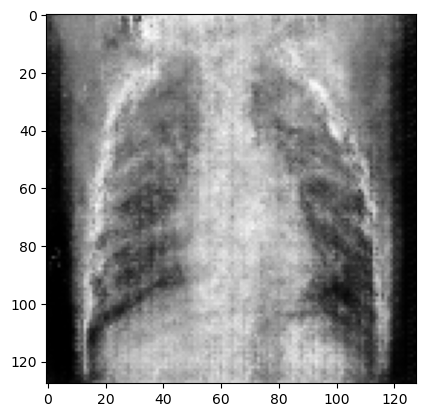

====== Epoch 172 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.20021165907382965, Generator: 7.130615234375


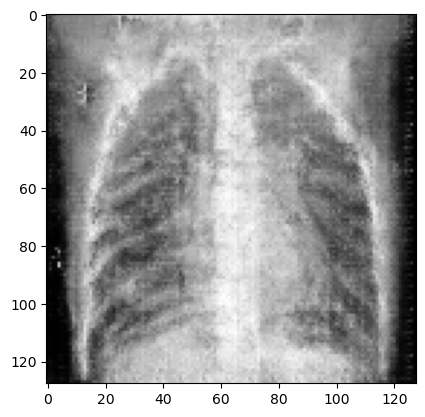

====== Epoch 173 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.19971224665641785, Generator: 7.05643892288208


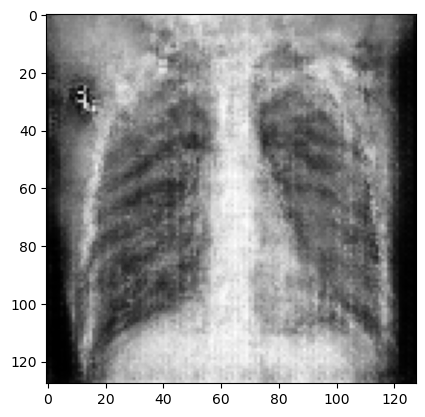

====== Epoch 174 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3512120246887207, Generator: 10.709890365600586


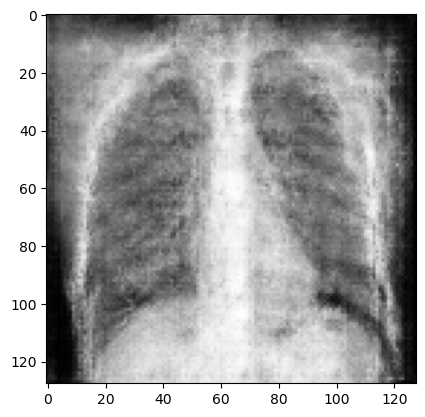

====== Epoch 175 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.12473481148481369, Generator: 5.485640525817871


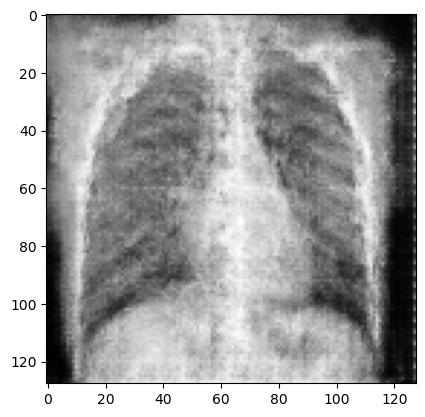

====== Epoch 176 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.1670002043247223, Generator: 6.973437786102295


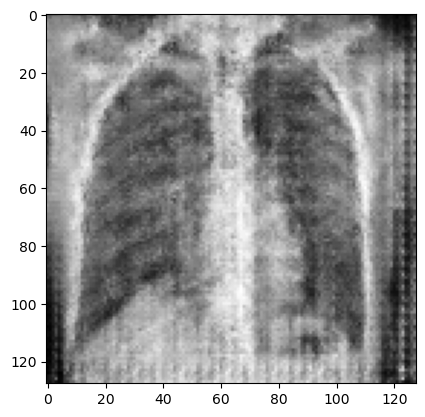

====== Epoch 177 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.08307816088199615, Generator: 6.951360702514648


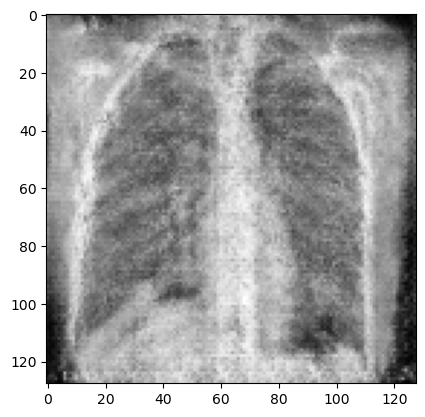

====== Epoch 178 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.8552539348602295, Generator: 10.471292495727539


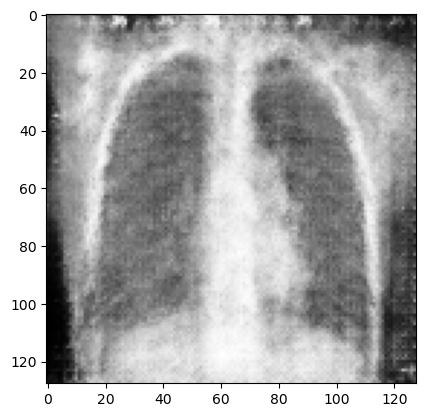

====== Epoch 179 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.33601680397987366, Generator: 6.292972087860107


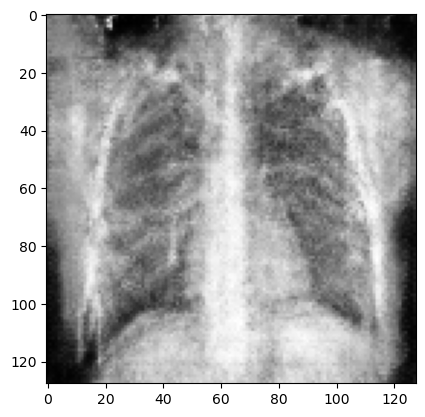

====== Epoch 180 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6511207222938538, Generator: 4.9284539222717285


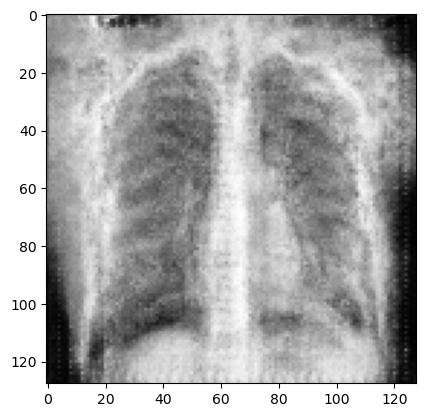

====== Epoch 181 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.16362276673316956, Generator: 7.633207321166992


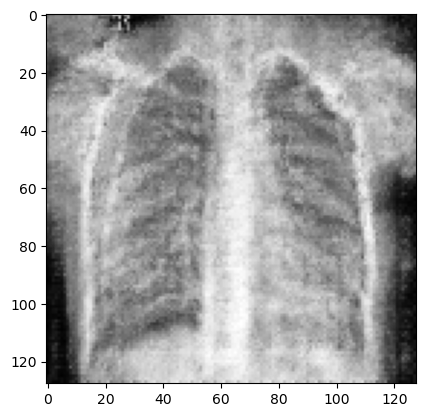

====== Epoch 182 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.40592002868652344, Generator: 6.435517311096191


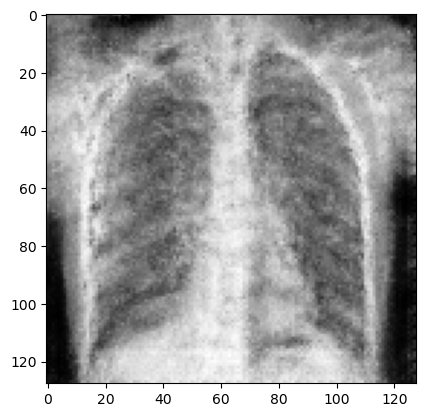

====== Epoch 183 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.5096811652183533, Generator: 7.550832748413086


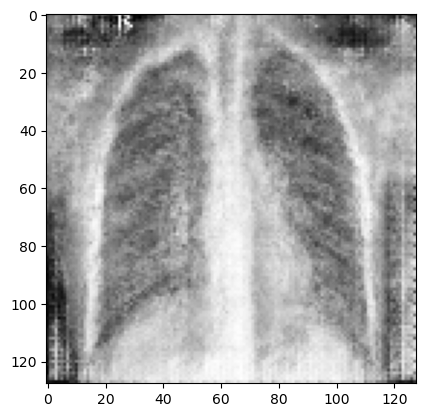

====== Epoch 184 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.1825716197490692, Generator: 4.5572509765625


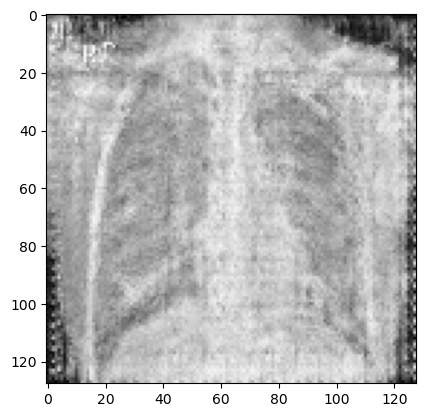

====== Epoch 185 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.6410396099090576, Generator: 7.923334121704102


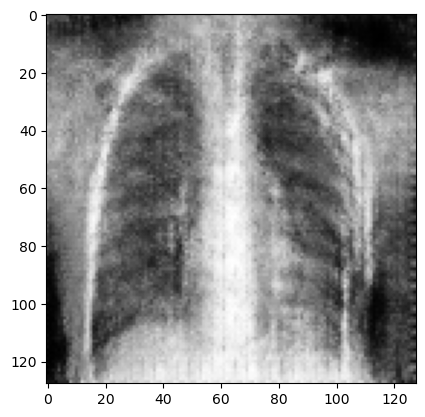

====== Epoch 186 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.16726037859916687, Generator: 7.130865097045898


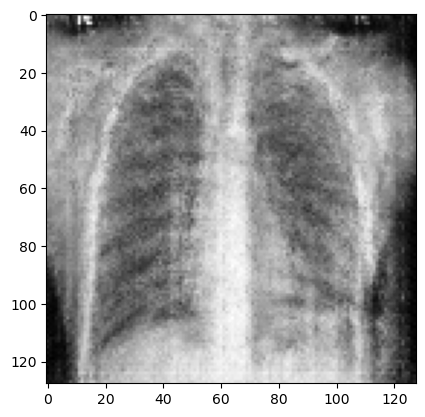

====== Epoch 187 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.3373481035232544, Generator: 7.007704734802246


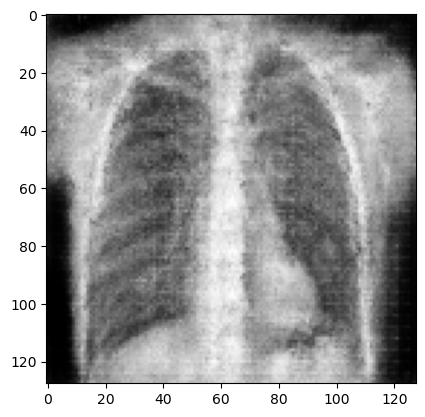

====== Epoch 188 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.19487708806991577, Generator: 7.744174480438232


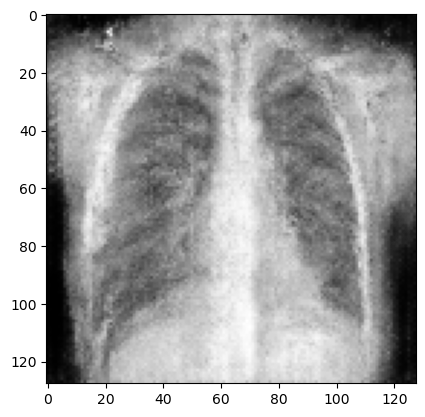

====== Epoch 189 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4422172009944916, Generator: 6.922019004821777


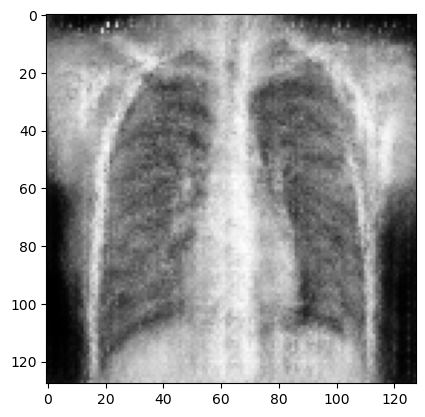

====== Epoch 190 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.1730463057756424, Generator: 5.757748126983643


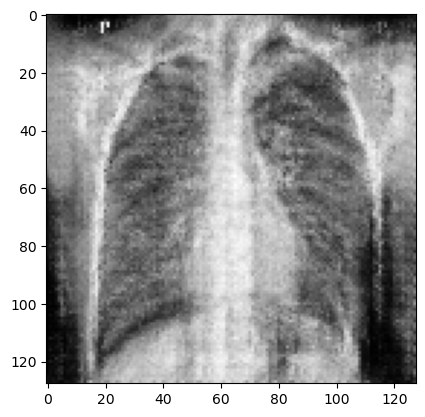

====== Epoch 191 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.20228524506092072, Generator: 7.4332404136657715


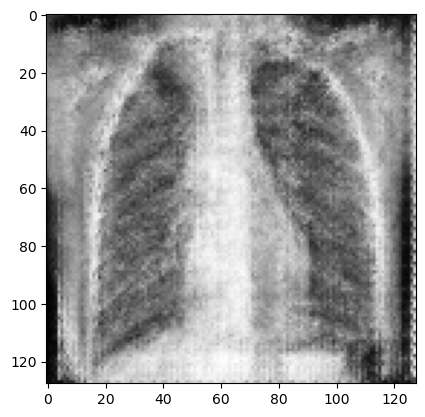

====== Epoch 192 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.24861744046211243, Generator: 7.449239730834961


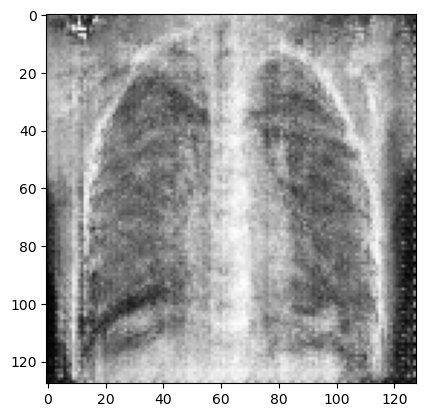

====== Epoch 193 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.17996424436569214, Generator: 6.969450950622559


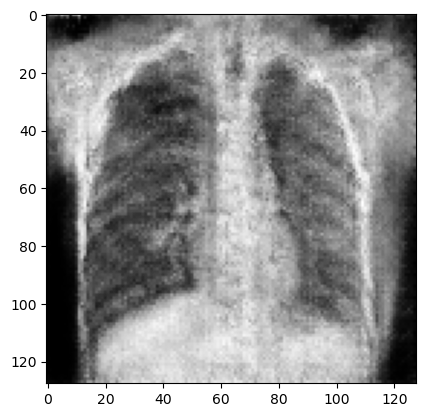

====== Epoch 194 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4254085123538971, Generator: 8.087754249572754


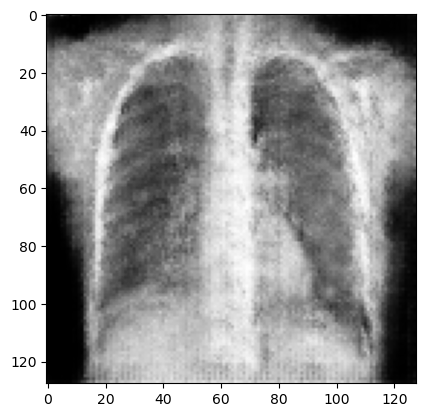

====== Epoch 195 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.4884171485900879, Generator: 11.138530731201172


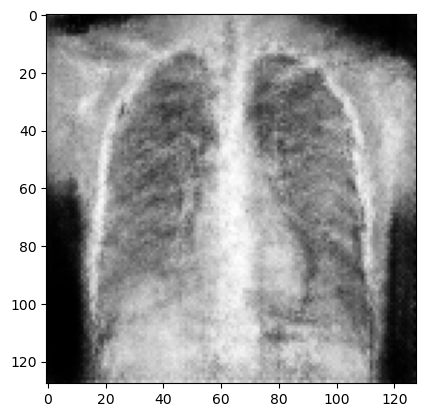

====== Epoch 196 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.13958615064620972, Generator: 5.2256903648376465


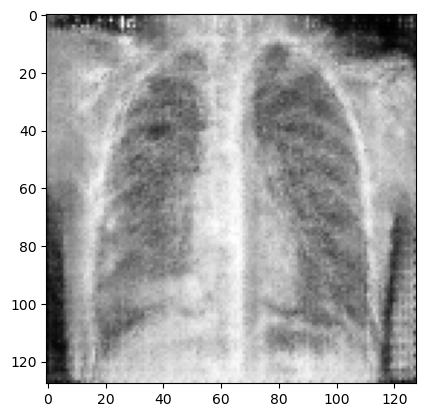

====== Epoch 197 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.11476098001003265, Generator: 8.608415603637695


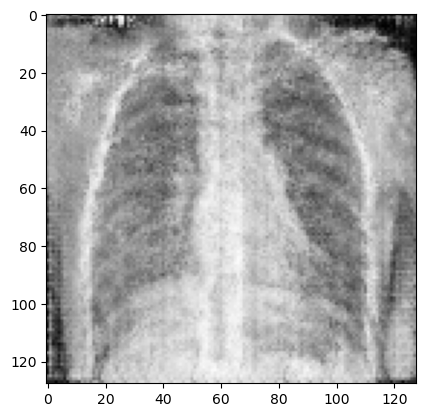

====== Epoch 198 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.11141232401132584, Generator: 6.064666748046875


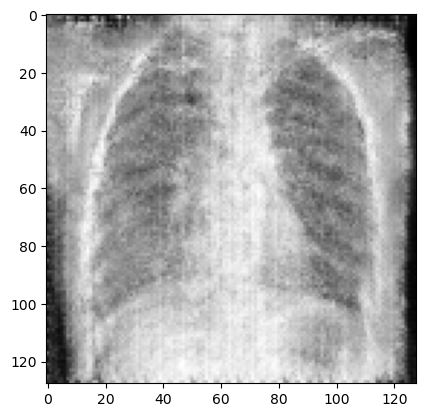

====== Epoch 199 ======
3 ... 6 ... 9 ... 12 ... 15 ... 
Discriminator: 0.07301929593086243, Generator: 5.218175888061523


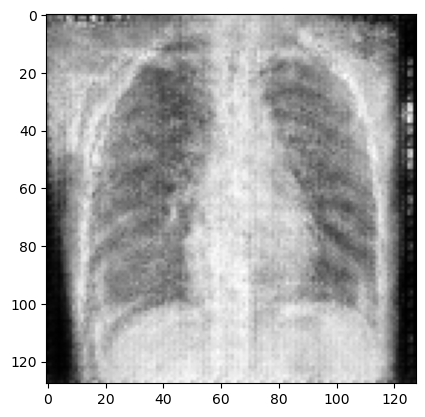

In [14]:
from tensorflow.keras.metrics import Mean

epochs = 200
fixed_noise = get_noise(5)

print("Base noise:")
fake_images = generator(fixed_noise, training=False).numpy()
plt.imshow(fake_images[0], cmap="gray")
plt.show()

for epoch in range(epochs):
    print("====== Epoch {:2d} ======".format(epoch))

    epoch_loss_d = Mean()
    epoch_loss_g = Mean()

    epoch_len = tf.data.experimental.cardinality(data_generator)
    for i, real_images in enumerate(data_generator):
        loss_d, loss_g = train_step(real_images)
        epoch_loss_d(loss_d)
        epoch_loss_g(loss_g)

        if i % 3 == 0 and i > 0:
            print(i, end=" ... ")

    print("\nDiscriminator: {}, Generator: {}".format(
        epoch_loss_d.result(), epoch_loss_g.result()))
    fake_images = generator(fixed_noise, training=False).numpy()
    plt.imshow(fake_images[0], cmap="gray")
    plt.show()    

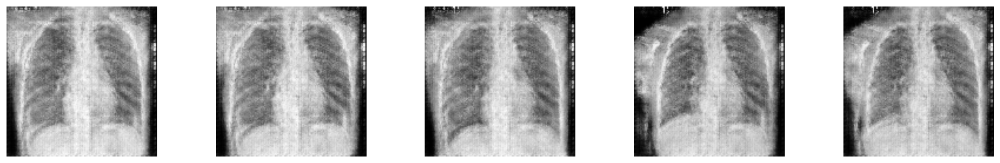

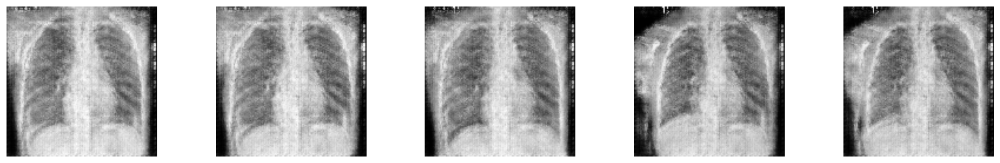

In [15]:
display(fake_images, row=1, col=5)